### Ön İşleme
### Orijinal Görüntü Yüklenmesi ve Gösterilmesi

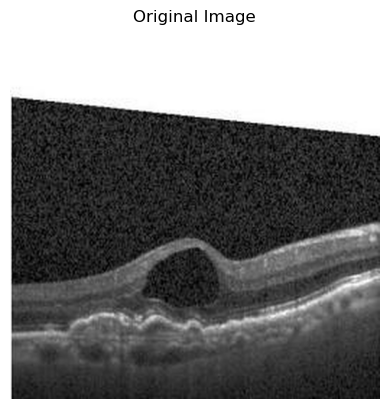

In [5]:
import cv2
import matplotlib.pyplot as plt

# Görseli yükle
image_path = "/Users/koray/Desktop/24/train/cnvt1.png"
image = cv2.imread(image_path)

# BGR'den RGB'ye dönüşüm (OpenCV BGR formatında okur)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Görseli göster
plt.imshow(image_rgb)
plt.title("Original Image")
plt.axis('off')  # Eksenleri kaldır
plt.show()

### L1 Norm Normalizasyonu

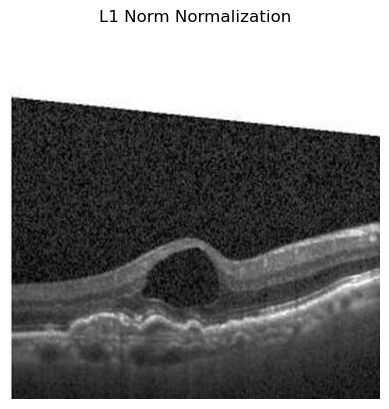

In [8]:
import numpy as np

# L1 norm normalizasyonu
l1_norm_image = np.abs(image_rgb).sum(axis=-1)

# Görseli göster
plt.imshow(l1_norm_image, cmap='gray')
plt.title("L1 Norm Normalization")
plt.axis('off')
plt.show()

### L2 Norm Normalizasyonu

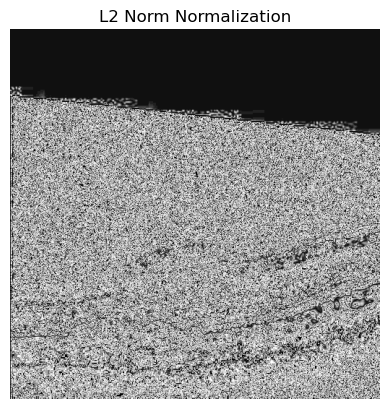

In [11]:
# L2 norm normalizasyonu
l2_norm_image = np.sqrt(np.sum(np.square(image_rgb), axis=-1))

# Görseli göster
plt.imshow(l2_norm_image, cmap='gray')
plt.title("L2 Norm Normalization")
plt.axis('off')
plt.show()

### Pipeline: MinMax Norm + Mean + Gamma

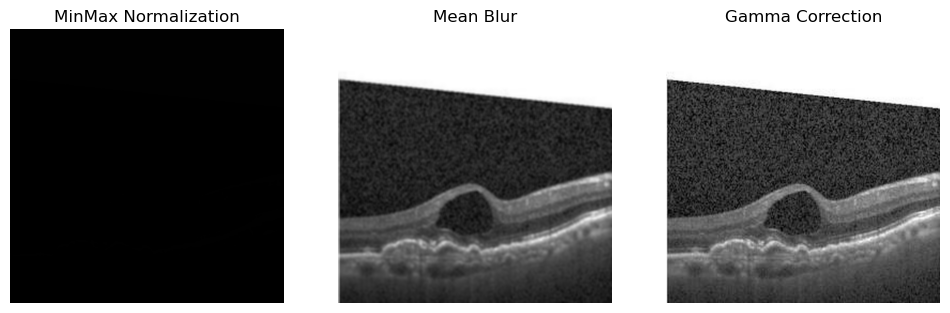

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü yükle
image_path = "/Users/koray/Desktop/24/train/cnvt1.png"
image = cv2.imread(image_path)

# 1. MinMax Normalization (0-1 aralığına sıkıştırma)
image_minmax = cv2.normalize(image, None, 0, 1, cv2.NORM_MINMAX)

# 2. Mean (Mean blur uygulama)
image_mean = cv2.blur(image, (5, 5))

# 3. Gamma Correction (Gamma düzeltmesi)
gamma = 1.2
lookUpTable = np.empty((1, 256), np.uint8)
for i in range(256):
    lookUpTable[0][i] = np.clip((i / 255.0) ** (1.0 / gamma) * 255.0, 0, 255)
image_gamma = cv2.LUT(image, lookUpTable)

# Görüntüleri göster
plt.figure(figsize=(12, 8))

plt.subplot(1, 3, 1)
plt.title("MinMax Normalization")
plt.imshow(image_minmax)
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Mean Blur")
plt.imshow(image_mean)
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Gamma Correction")
plt.imshow(image_gamma)
plt.axis("off")

plt.show()

### BRISQUE Skoru ile Görüntü Kalitesini Değerlendirme ( Normalizasyon ) 
### Hata verdiği  için scikit-image ile SSIM Kullanıldı

In [21]:
from skimage.metrics import structural_similarity as ssim
import cv2
import numpy as np

# SSIM hesaplama fonksiyonu
def calculate_ssim(original, processed):
    # Görüntüleri gri tonlamaya çevir
    original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
    processed_gray = cv2.cvtColor(processed, cv2.COLOR_BGR2GRAY)
    
    # SSIM skorunu hesapla
    score, _ = ssim(original_gray, processed_gray, full=True)
    return score

# Görüntüyü yükleyelim
image_path = '/Users/koray/Desktop/24/train/cnvt1.png'  # Görüntü yolunuzu buraya ekleyin
image = cv2.imread(image_path)  # Görüntüyü yükledik

# Görüntüyü normalize edelim: L1, L2 ve MinMax normalizasyonlarını yapalım
l1_normalized_image = cv2.normalize(image, None, 0, 255, cv2.NORM_L1)
l2_normalized_image = cv2.normalize(image, None, 0, 255, cv2.NORM_L2)
minmax_normalized_image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)

# SSIM skorlarını hesaplayalım
original_ssim = calculate_ssim(image, image)  # Kendisiyle karşılaştırıldığında 1 olmalı
l1_ssim = calculate_ssim(image, l1_normalized_image)
l2_ssim = calculate_ssim(image, l2_normalized_image)
minmax_ssim = calculate_ssim(image, minmax_normalized_image)

# Sonuçları yazdıralım
print("Orijinal Görüntü SSIM Skoru:", original_ssim)
print("L1 Norm SSIM Skoru:", l1_ssim)
print("L2 Norm SSIM Skoru:", l2_ssim)
print("MinMax SSIM Skoru:", minmax_ssim)

Orijinal Görüntü SSIM Skoru: 1.0
L1 Norm SSIM Skoru: 0.00107986289120387
L2 Norm SSIM Skoru: 0.00107986289120387
MinMax SSIM Skoru: 1.0


### Mean Yumuşatma (Average Filtering)

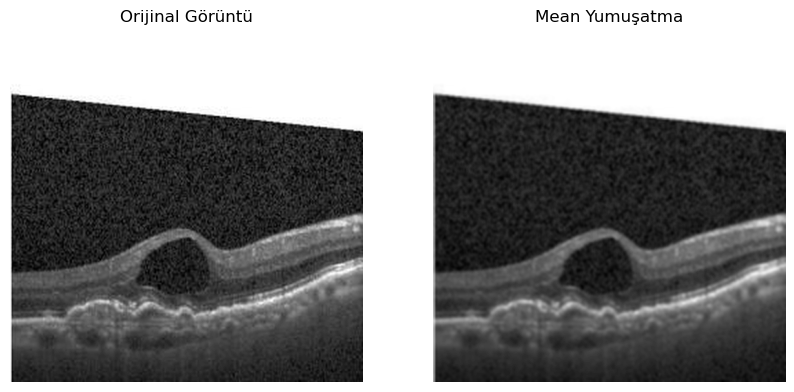

In [24]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Dosya yolunu kullanarak görüntüyü yükleyelim
image_path = "/Users/koray/Desktop/24/train/cnvt1.png"
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Mean filtre (ortalamayla yumuşatma)
mean_filtered_image = cv2.blur(image, (5, 5))

# Görüntüleri gösterelim
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Orijinal Görüntü')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mean_filtered_image, cmap='gray')
plt.title('Mean Yumuşatma')
plt.axis('off')

plt.show()

### Median Yumuşatma

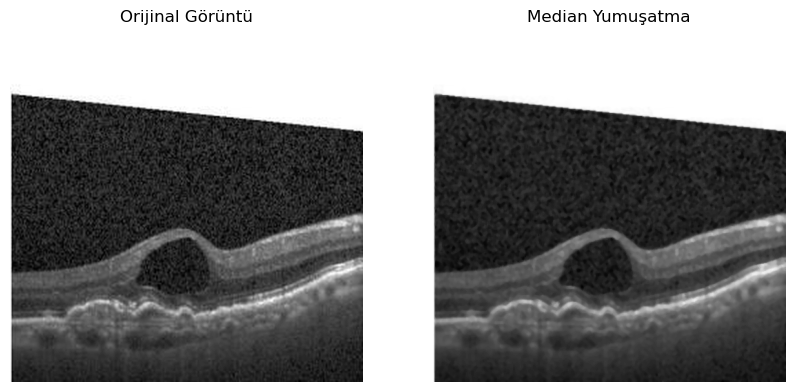

In [27]:
# Median filtre (medyanla yumuşatma)
median_filtered_image = cv2.medianBlur(image, 5)

# Görüntüleri gösterelim
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Orijinal Görüntü')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(median_filtered_image, cmap='gray')
plt.title('Median Yumuşatma')
plt.axis('off')

plt.show()

### Adaptif Median Yumuşatma

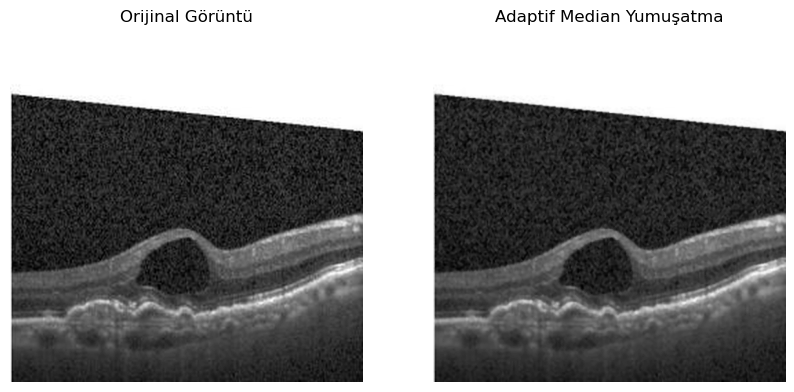

In [30]:
def adaptive_median_filter(image, max_filter_size=7):
    image_copy = image.copy()
    rows, cols = image.shape
    for i in range(rows):
        for j in range(cols):
            filter_size = 3
            while filter_size <= max_filter_size:
                half_filter_size = filter_size // 2
                region = image[max(0, i-half_filter_size):min(rows, i+half_filter_size+1),
                               max(0, j-half_filter_size):min(cols, j+half_filter_size+1)]
                region_median = np.median(region)
                region_min = np.min(region)
                region_max = np.max(region)
                
                if region_min < region_median < region_max:
                    image_copy[i, j] = region_median
                    break
                filter_size += 2
    return image_copy

# Adaptif Median filtre (uyarlanabilir medyanla yumuşatma)
adaptive_median_filtered_image = adaptive_median_filter(image)

# Görüntüleri gösterelim
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Orijinal Görüntü')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(adaptive_median_filtered_image, cmap='gray')
plt.title('Adaptif Median Yumuşatma')
plt.axis('off')
## yp koy
plt.show()

###  BRISQUE Skoru ile Görüntü Kalitesini Değerlendirme ( Yumuşatma )
### Hata verdiği  için scikit-image ile SSIM Kullanıldı

Orijinal Görüntü SSIM Skoru: 1.0000
Mean Yumuşatma Görüntüsü SSIM Skoru: 0.8357


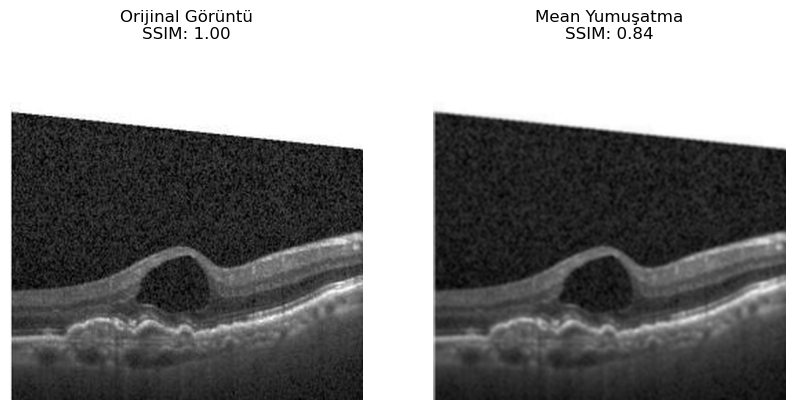

In [35]:
from skimage.metrics import structural_similarity as ssim
import cv2
import numpy as np
import matplotlib.pyplot as plt

# SSIM hesaplama fonksiyonu
def calculate_ssim(original, processed):
    # SSIM sadece gri tonlamalı görüntülerle çalışır
    score, _ = ssim(original, processed, full=True)
    return score

# Dosya yolunu kullanarak görüntüyü yükleyelim
image_path = "/Users/koray/Desktop/24/train/cnvt1.png"
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Yumuşatma işlemi: Mean Yumuşatma
mean_filtered_image = cv2.blur(image, (5, 5))

# Orijinal görüntü ve Mean yumuşatma sonrasında SSIM hesaplama
original_ssim_score = calculate_ssim(image, image)  # Kendisiyle karşılaştırma, 1.0 olmalı
mean_ssim_score = calculate_ssim(image, mean_filtered_image)

# Sonuçları yazdıralım
print(f"Orijinal Görüntü SSIM Skoru: {original_ssim_score:.4f}")
print(f"Mean Yumuşatma Görüntüsü SSIM Skoru: {mean_ssim_score:.4f}")

# Görüntüleri gösterelim
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(image, cmap='gray')
plt.title(f'Orijinal Görüntü\nSSIM: {original_ssim_score:.2f}')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mean_filtered_image, cmap='gray')
plt.title(f'Mean Yumuşatma\nSSIM: {mean_ssim_score:.2f}')
plt.axis('off')

plt.show()

### Görüntü Ön İşleme Adımları

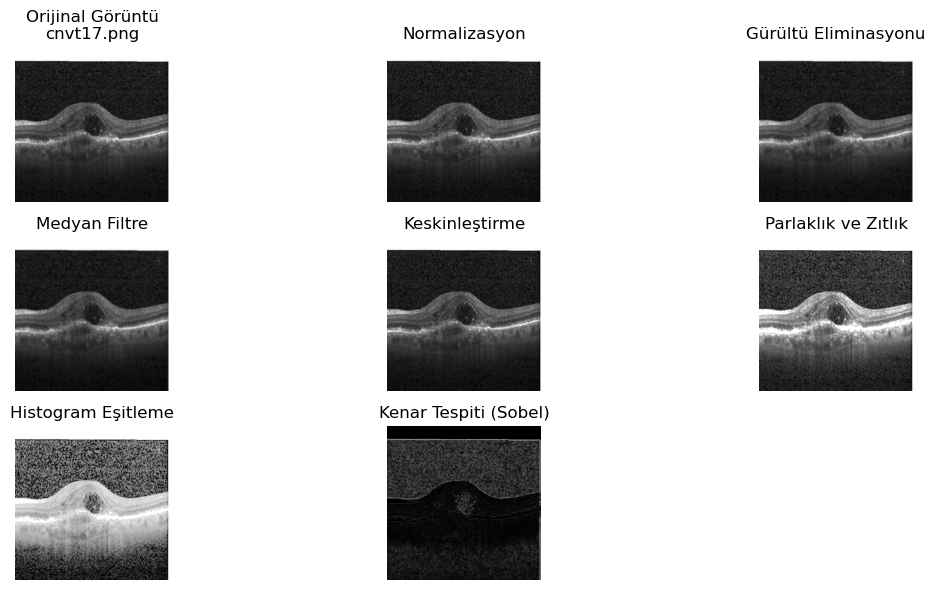

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt17.png
--------------------------------------------------


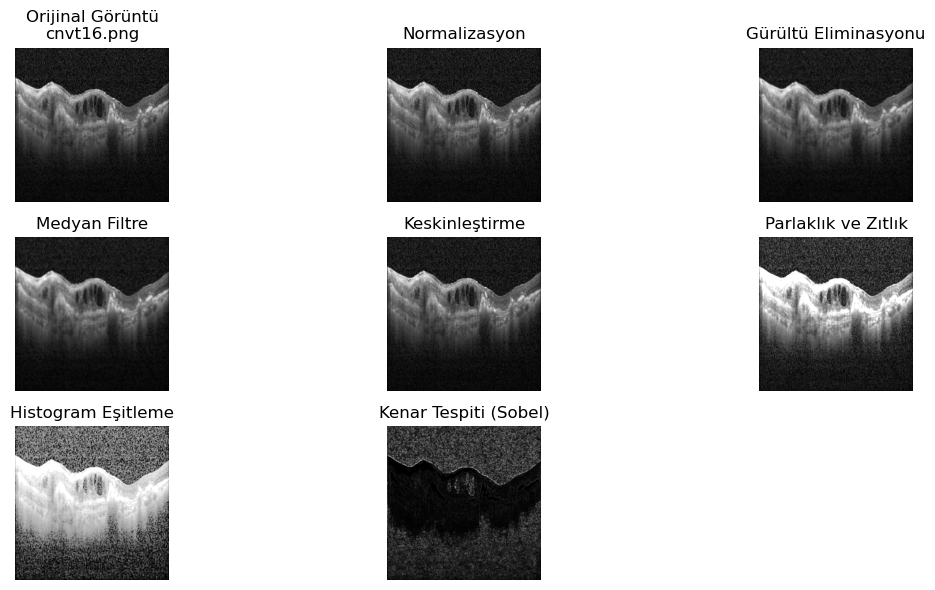

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt16.png
--------------------------------------------------


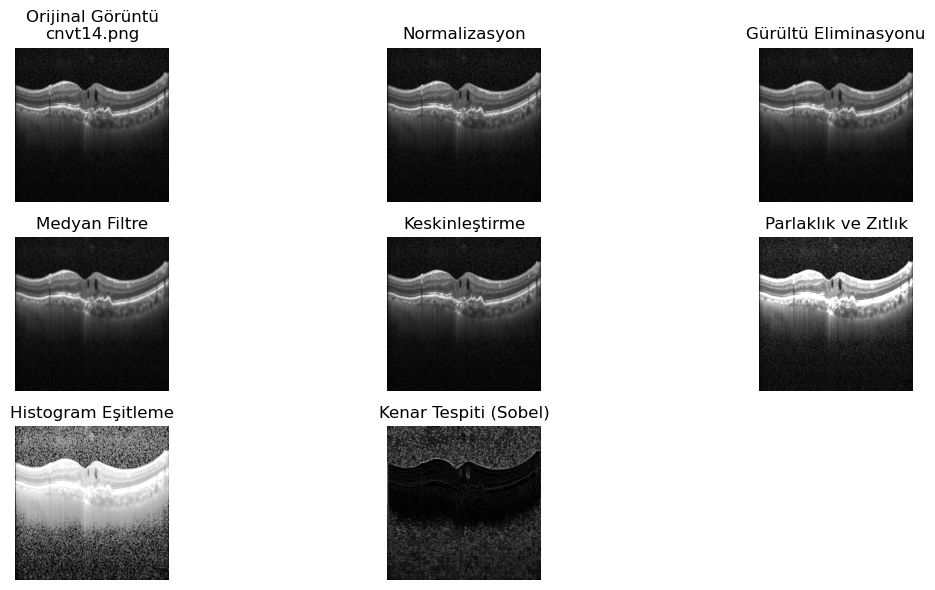

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt14.png
--------------------------------------------------


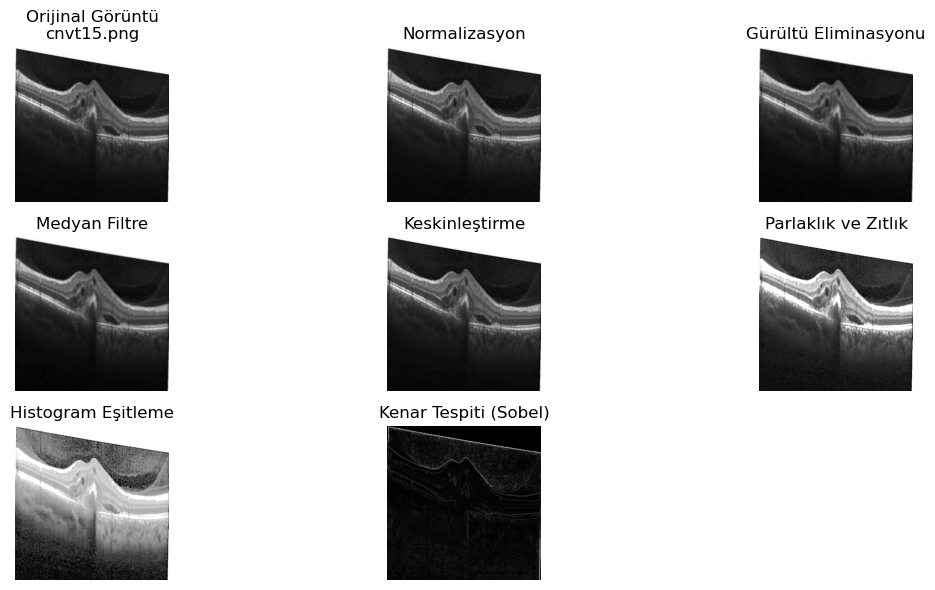

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt15.png
--------------------------------------------------


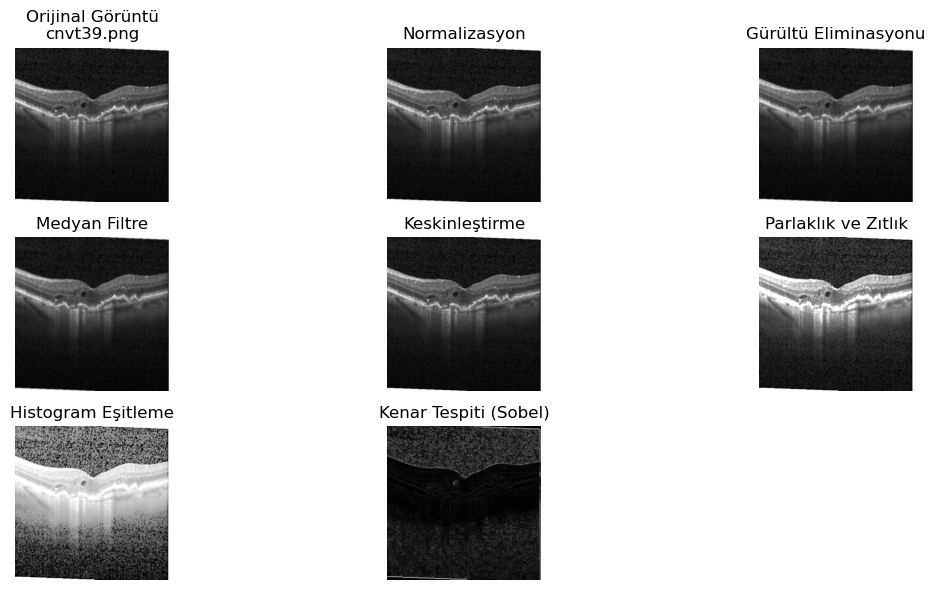

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt39.png
--------------------------------------------------


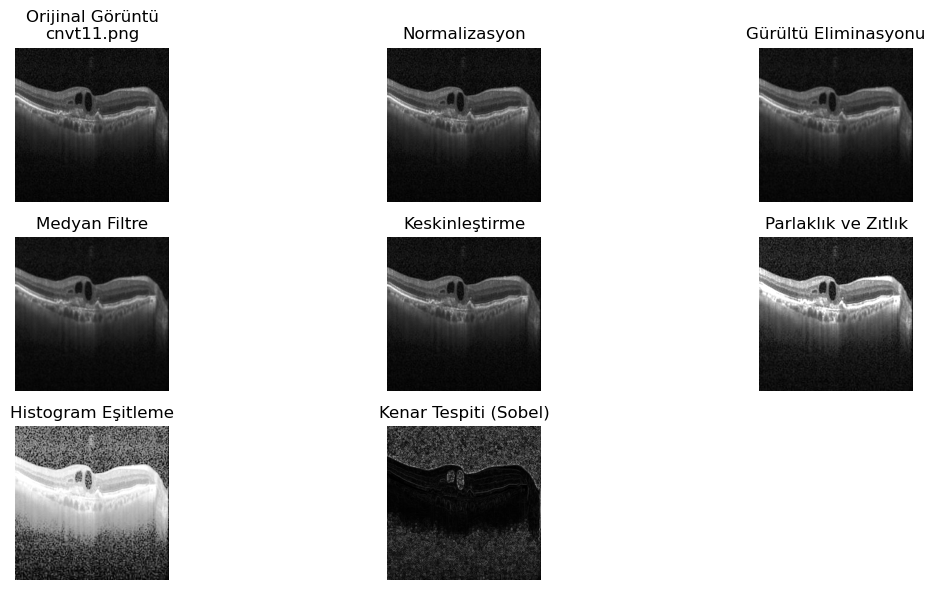

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt11.png
--------------------------------------------------
Hata: Görüntü '/Users/koray/Desktop/24/train/.DS_Store' yüklenemedi.


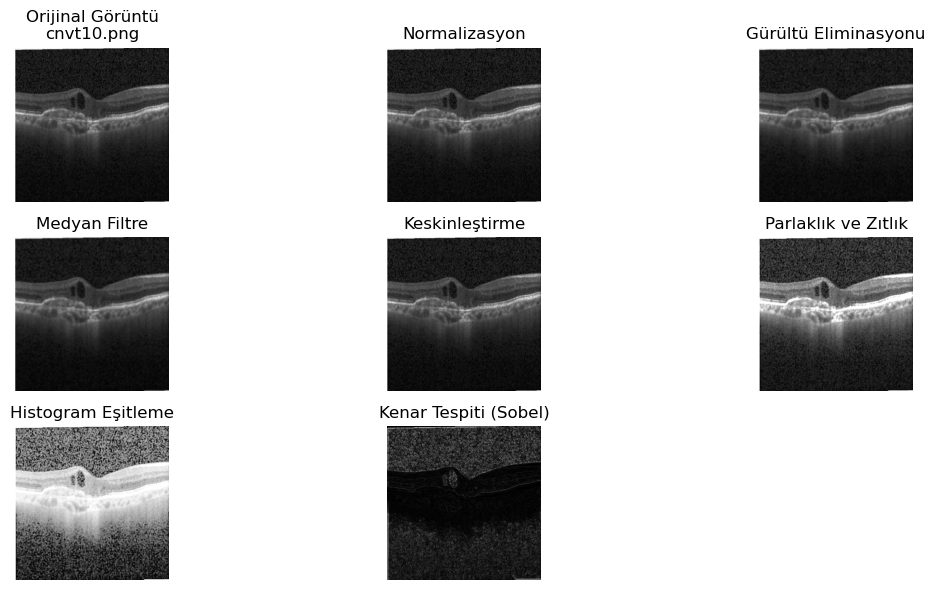

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt10.png
--------------------------------------------------


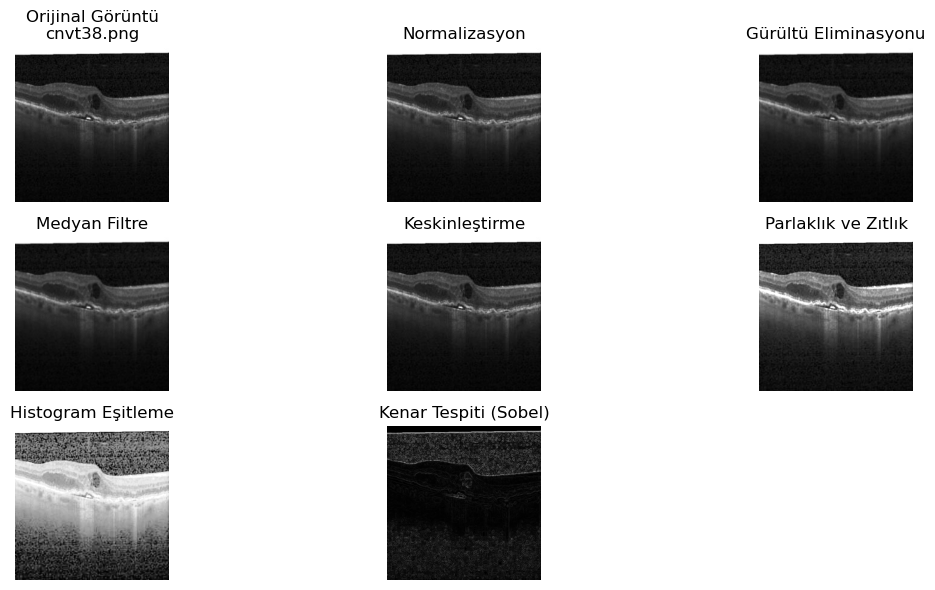

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt38.png
--------------------------------------------------


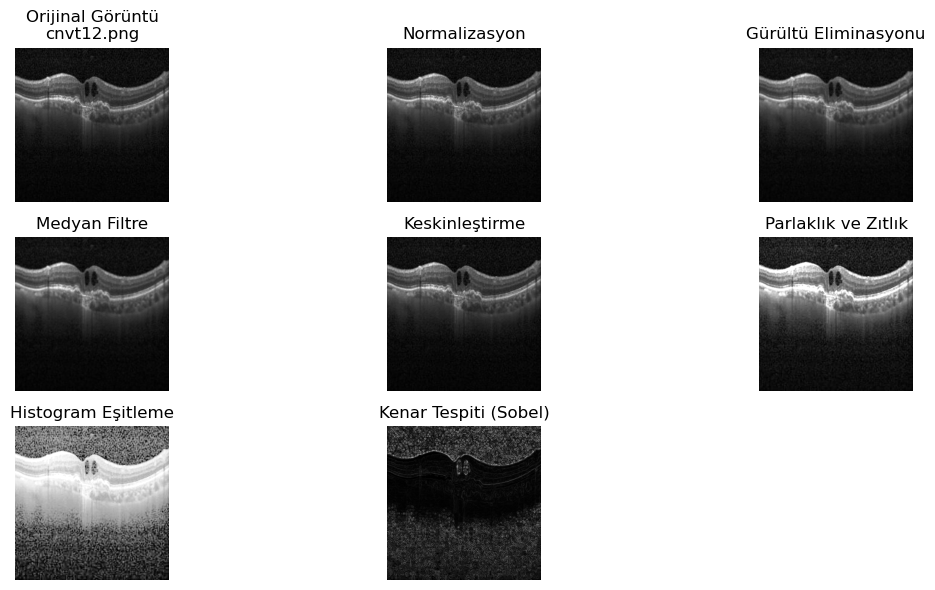

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt12.png
--------------------------------------------------


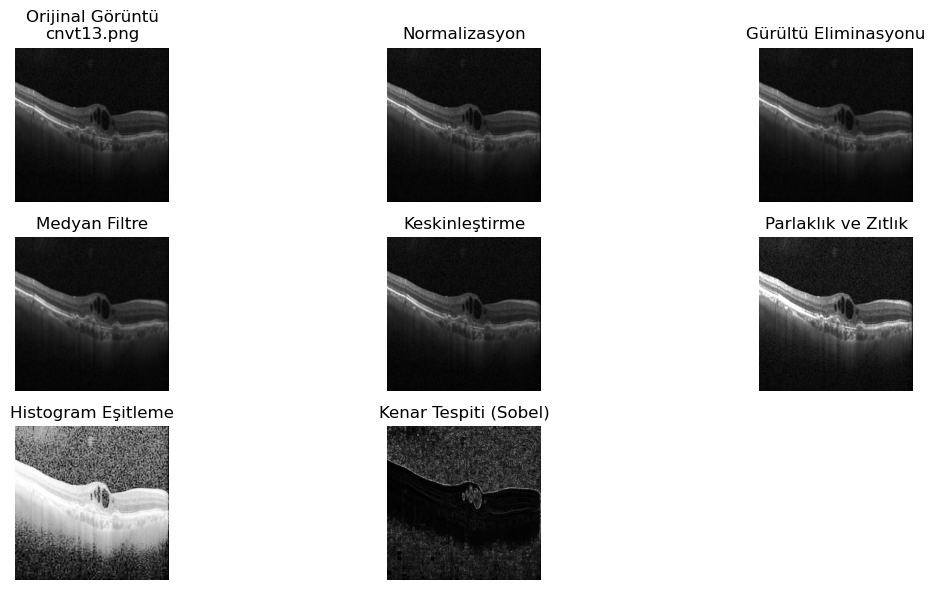

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt13.png
--------------------------------------------------


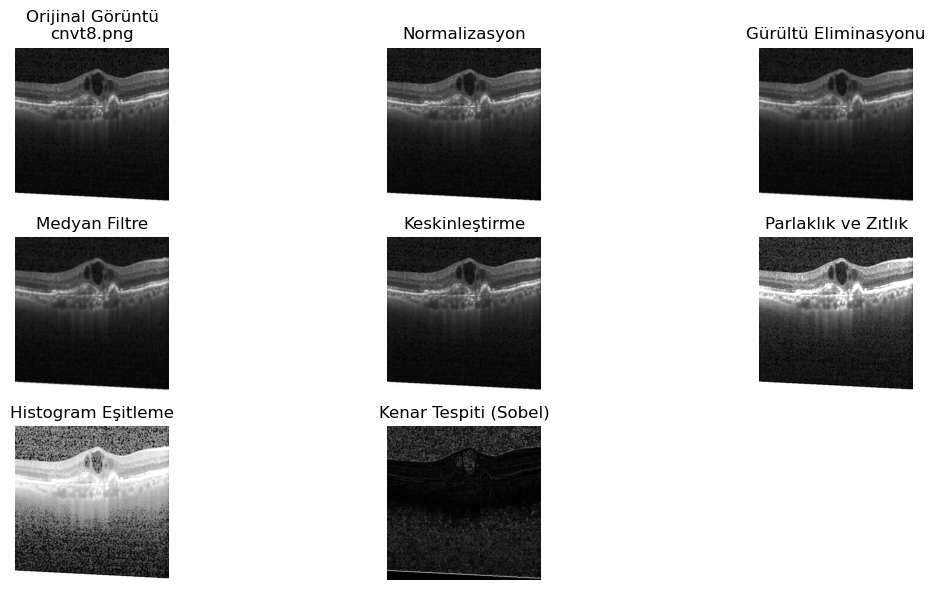

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt8.png
--------------------------------------------------


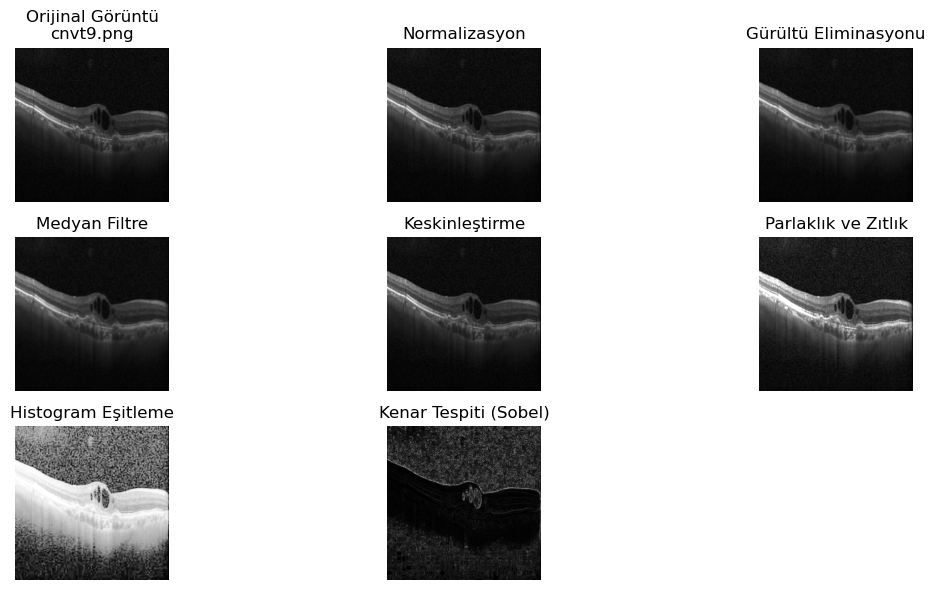

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt9.png
--------------------------------------------------


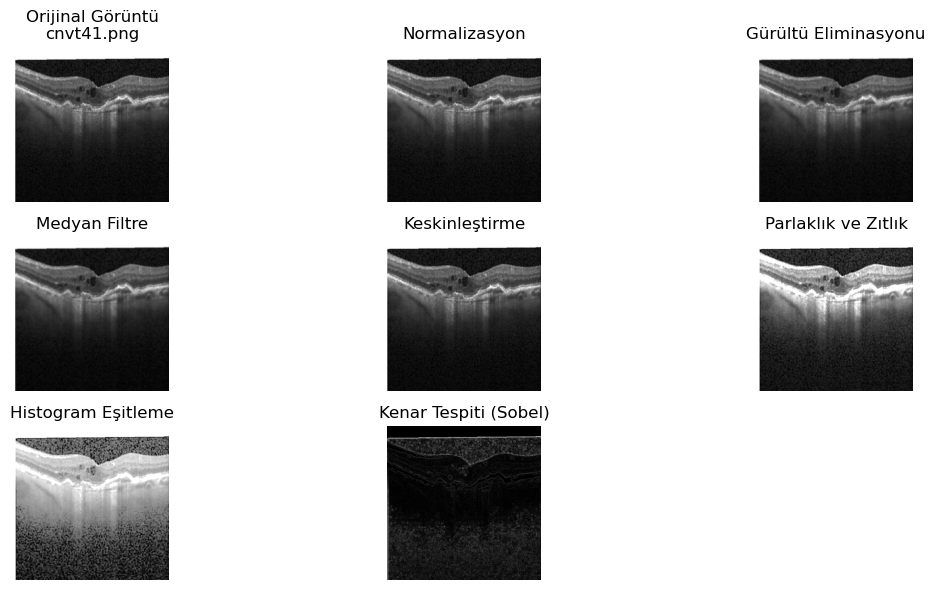

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt41.png
--------------------------------------------------


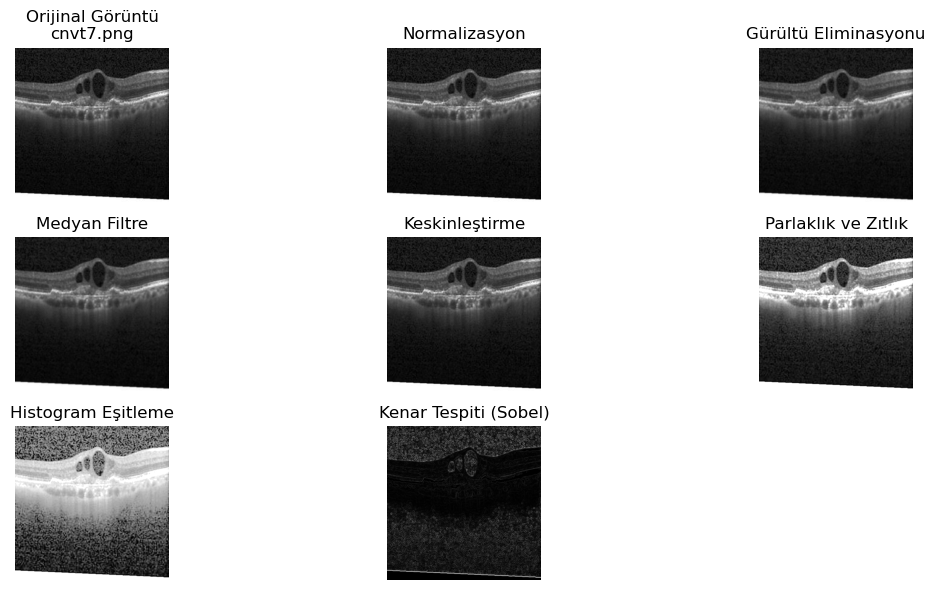

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt7.png
--------------------------------------------------


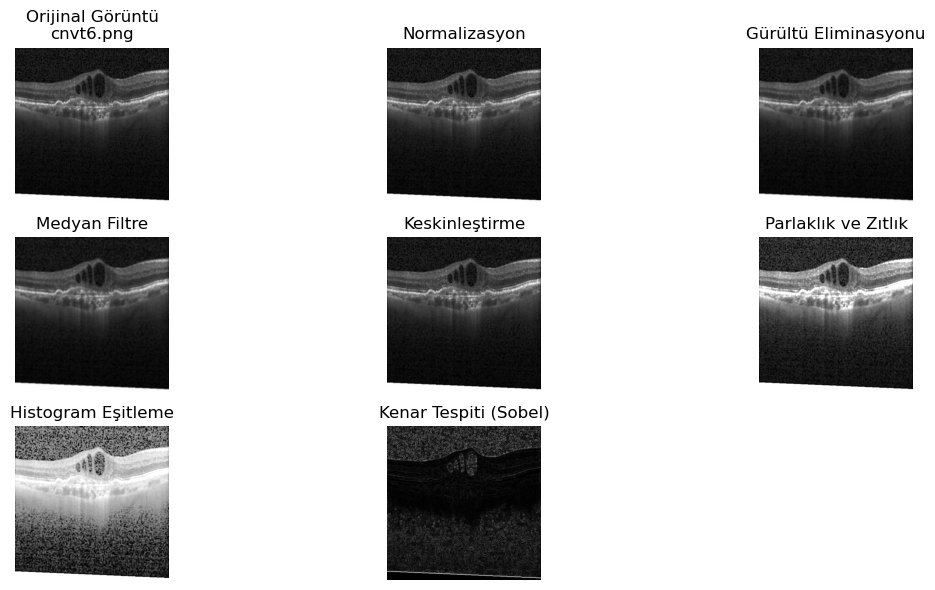

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt6.png
--------------------------------------------------


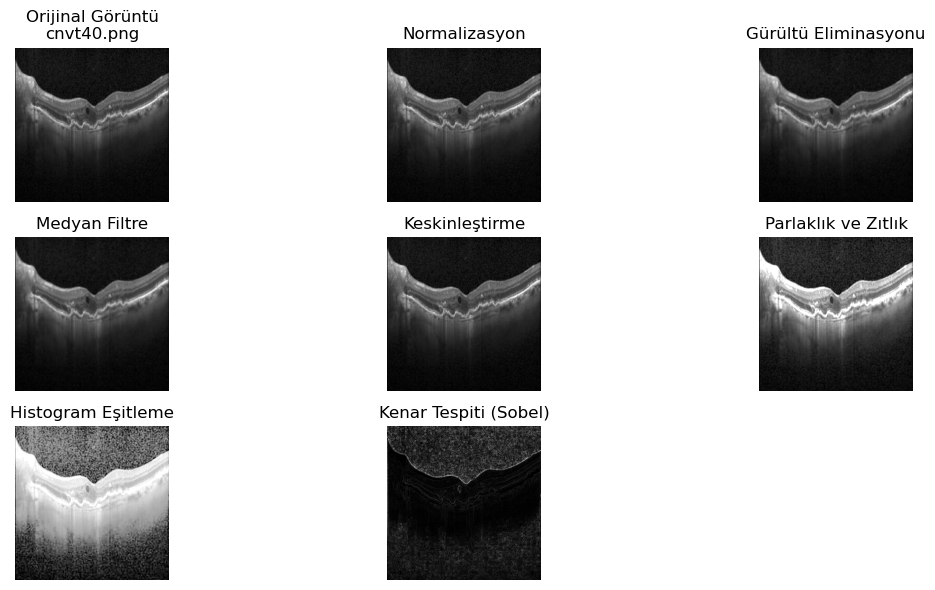

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt40.png
--------------------------------------------------


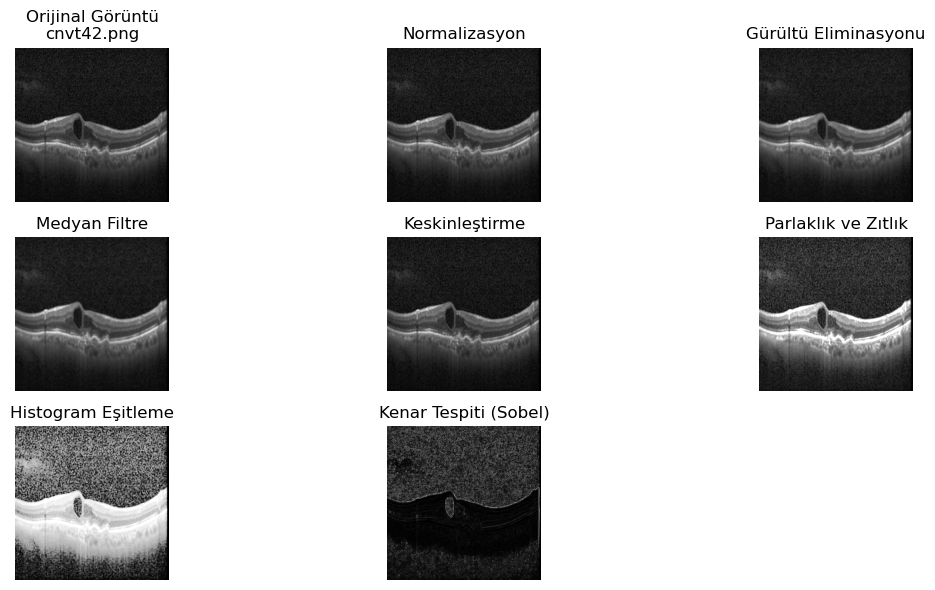

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt42.png
--------------------------------------------------


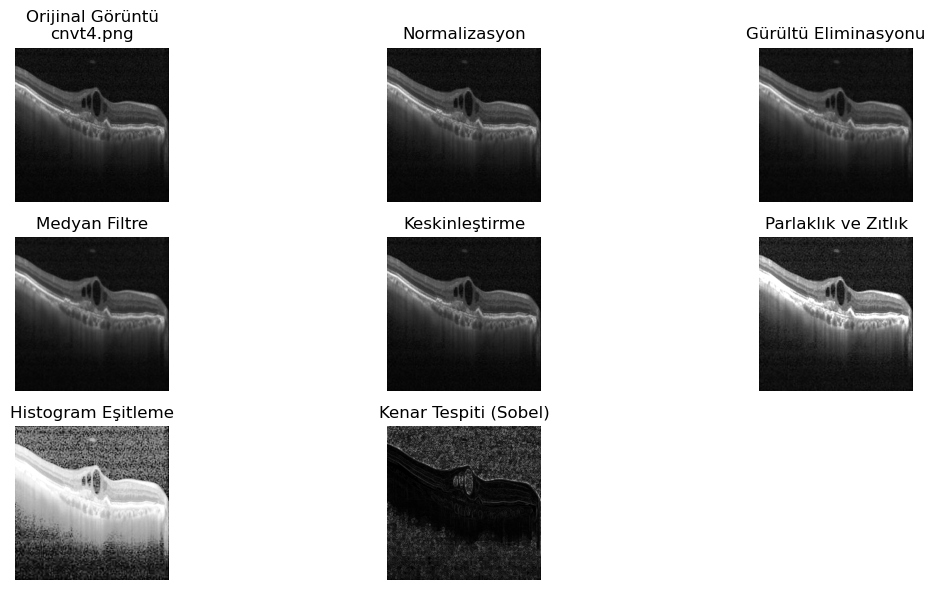

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt4.png
--------------------------------------------------


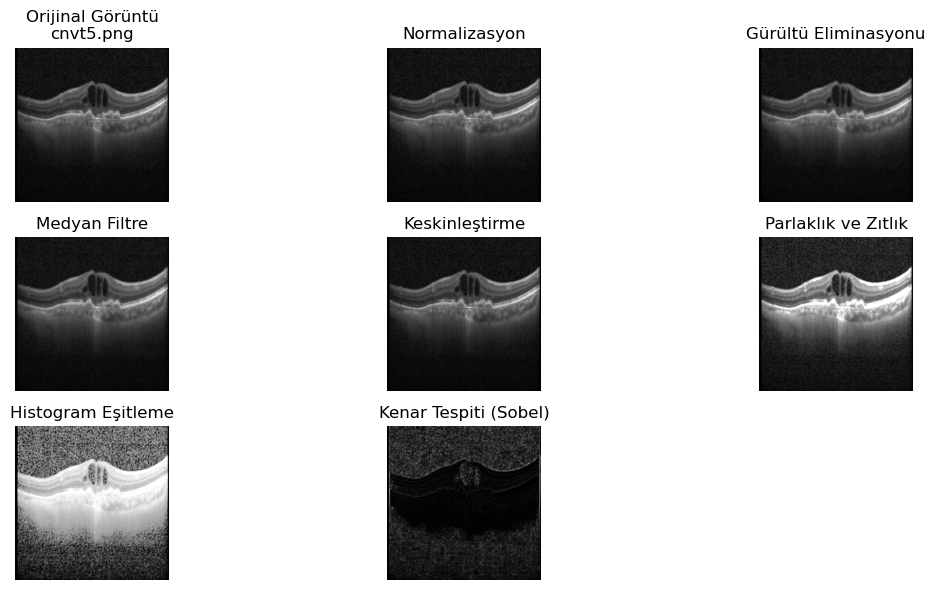

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt5.png
--------------------------------------------------


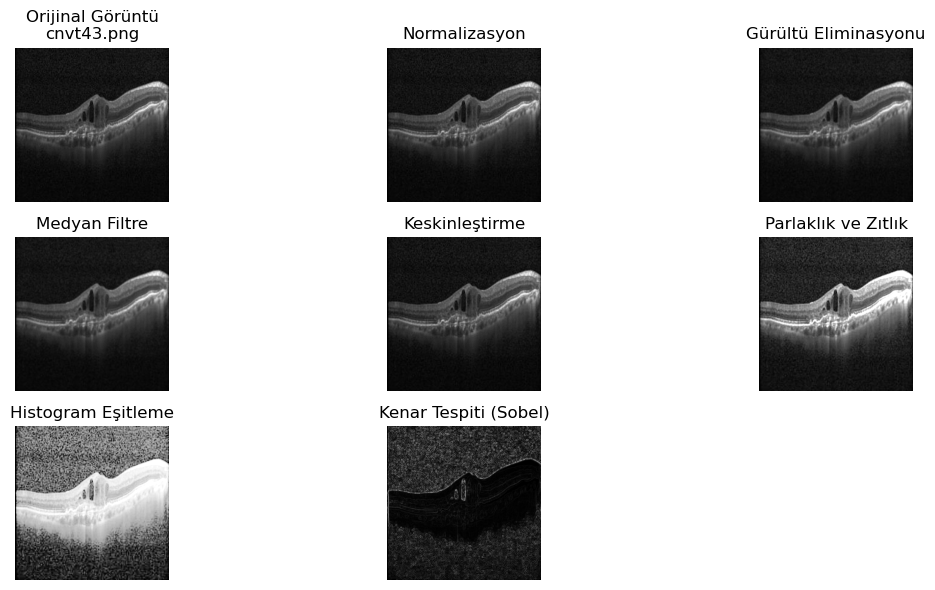

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt43.png
--------------------------------------------------


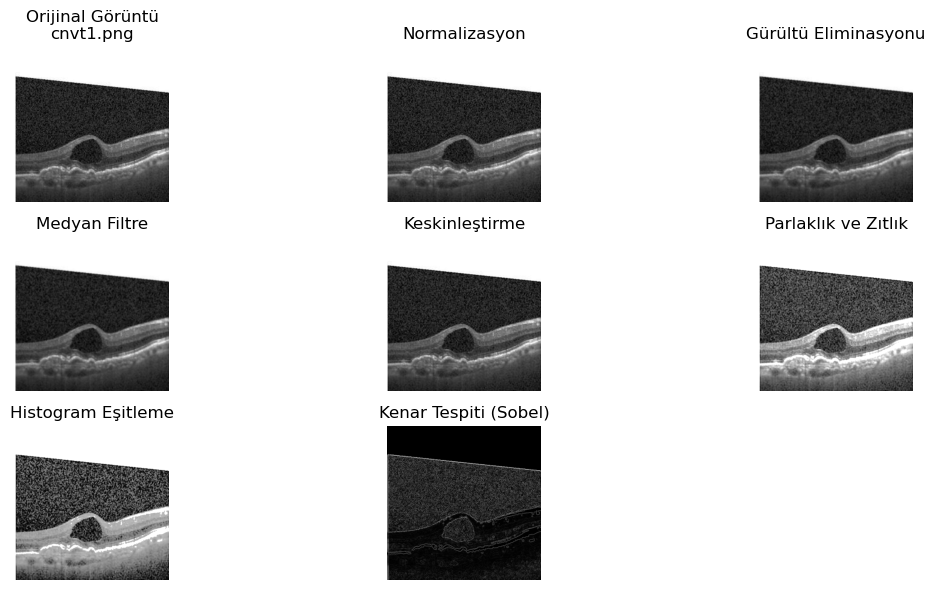

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt1.png
--------------------------------------------------


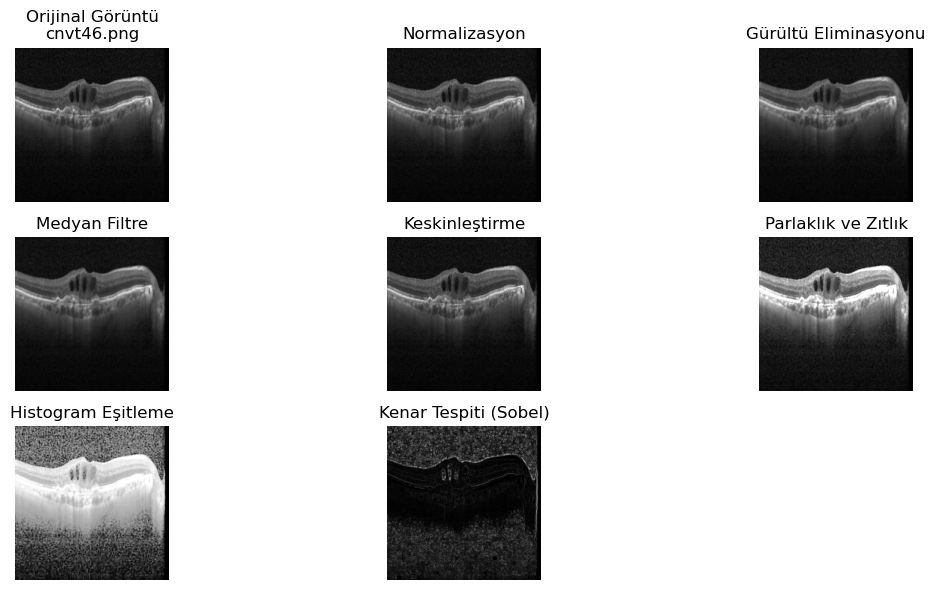

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt46.png
--------------------------------------------------


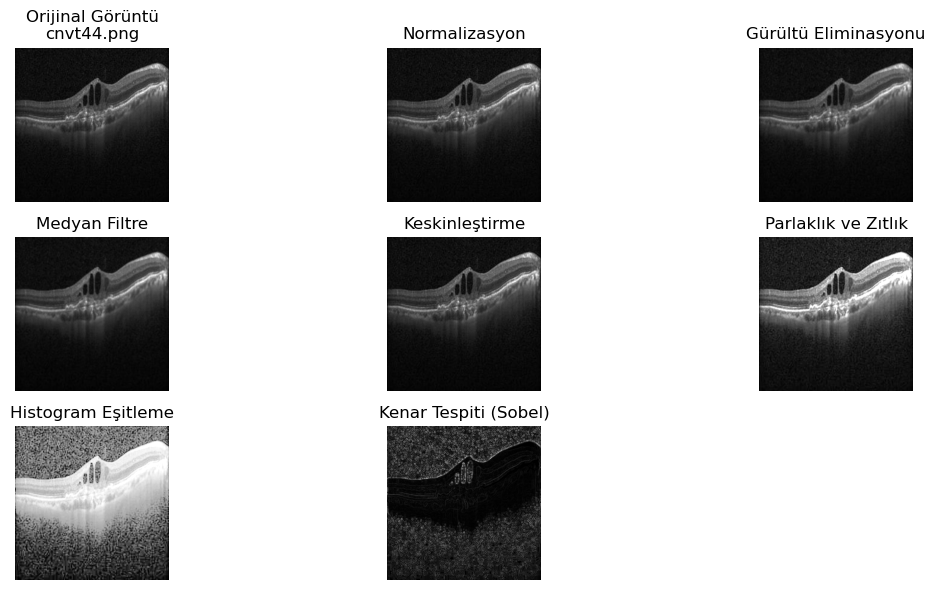

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt44.png
--------------------------------------------------


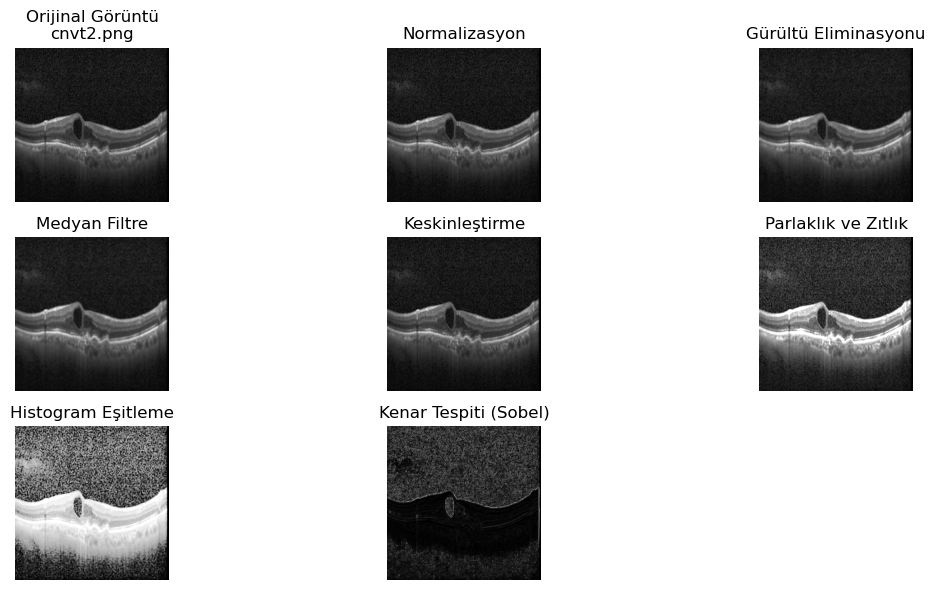

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt2.png
--------------------------------------------------


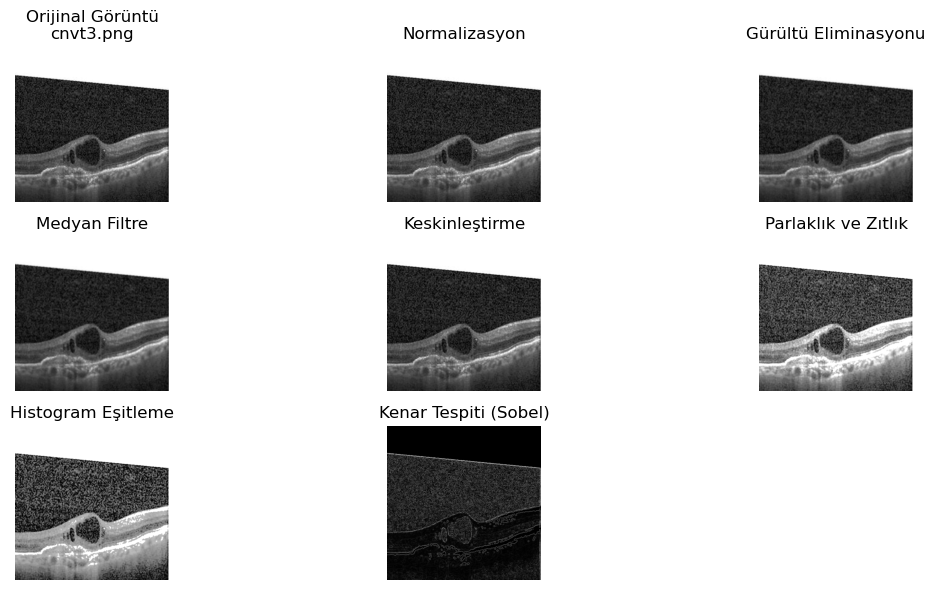

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt3.png
--------------------------------------------------


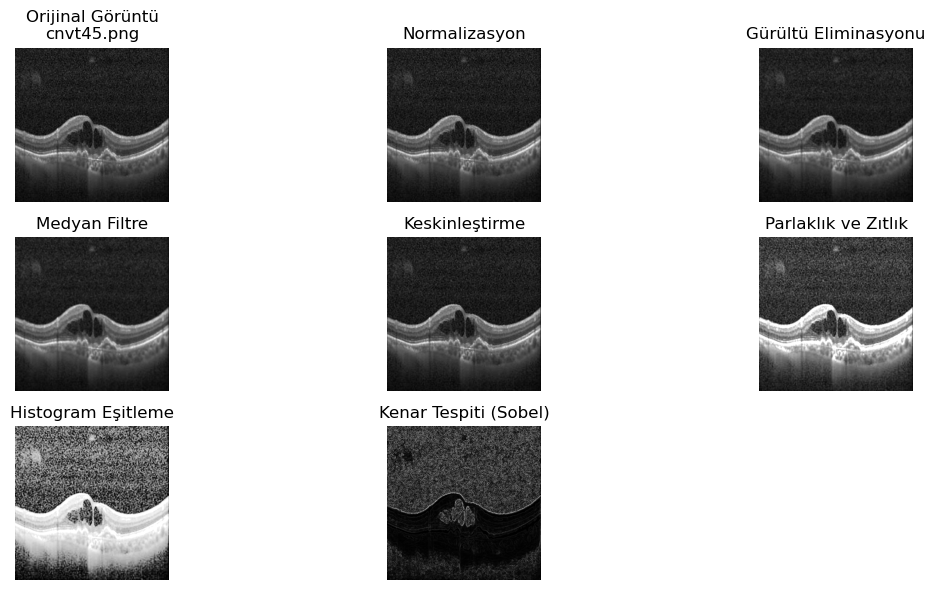

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt45.png
--------------------------------------------------


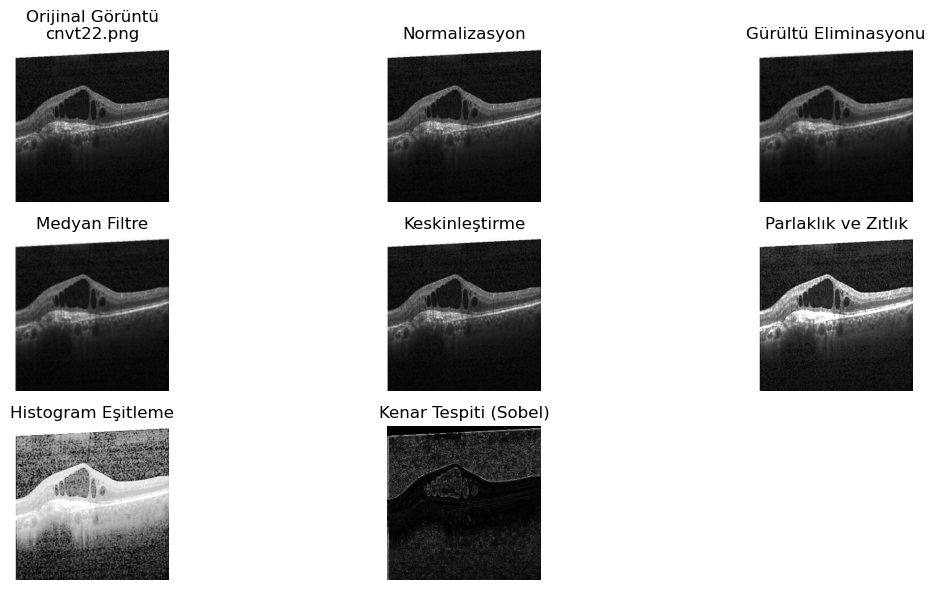

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt22.png
--------------------------------------------------


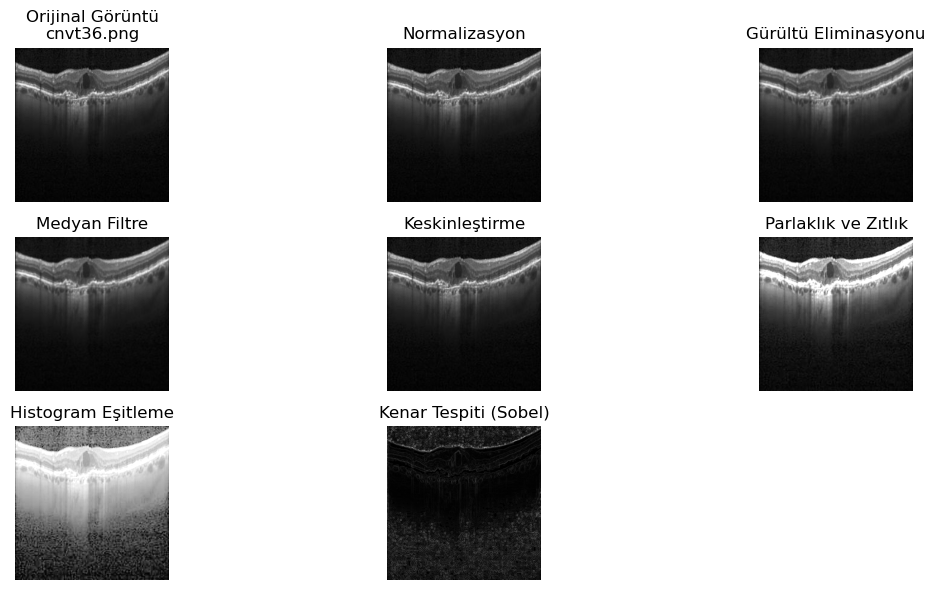

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt36.png
--------------------------------------------------


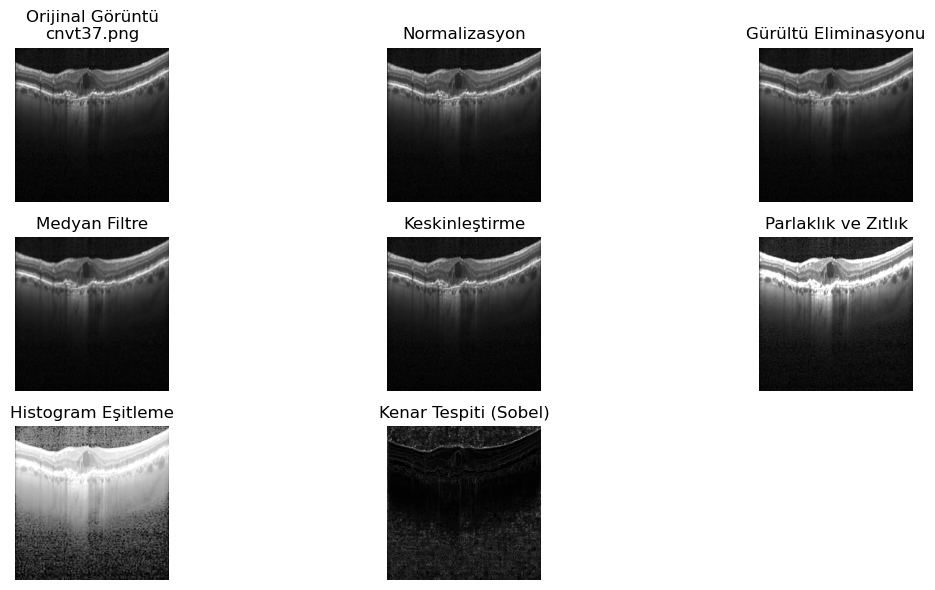

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt37.png
--------------------------------------------------


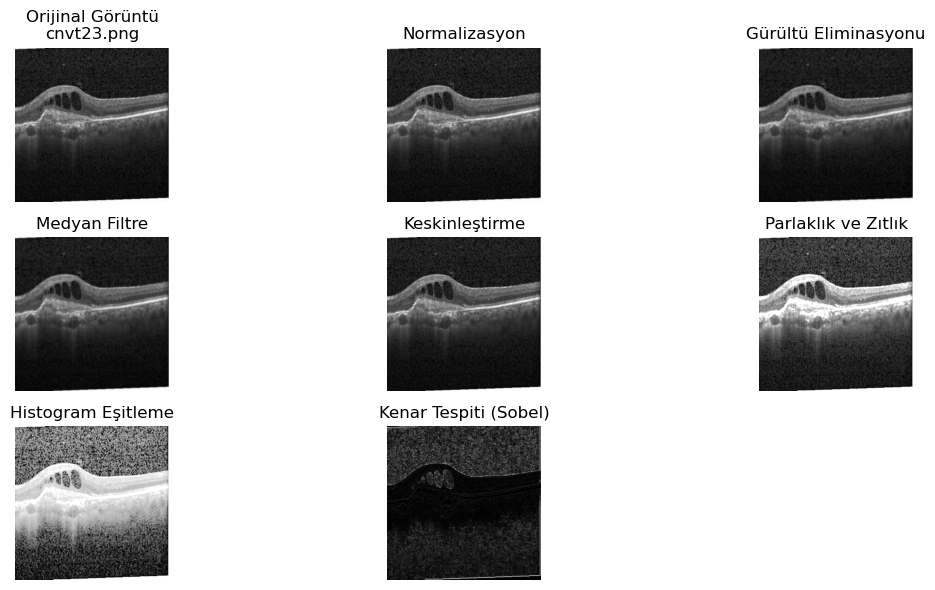

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt23.png
--------------------------------------------------


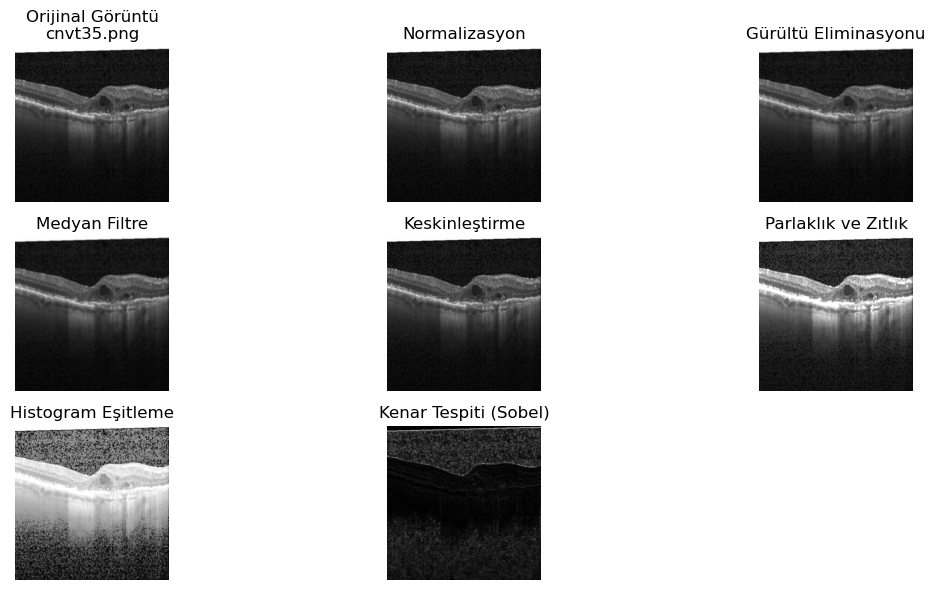

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt35.png
--------------------------------------------------


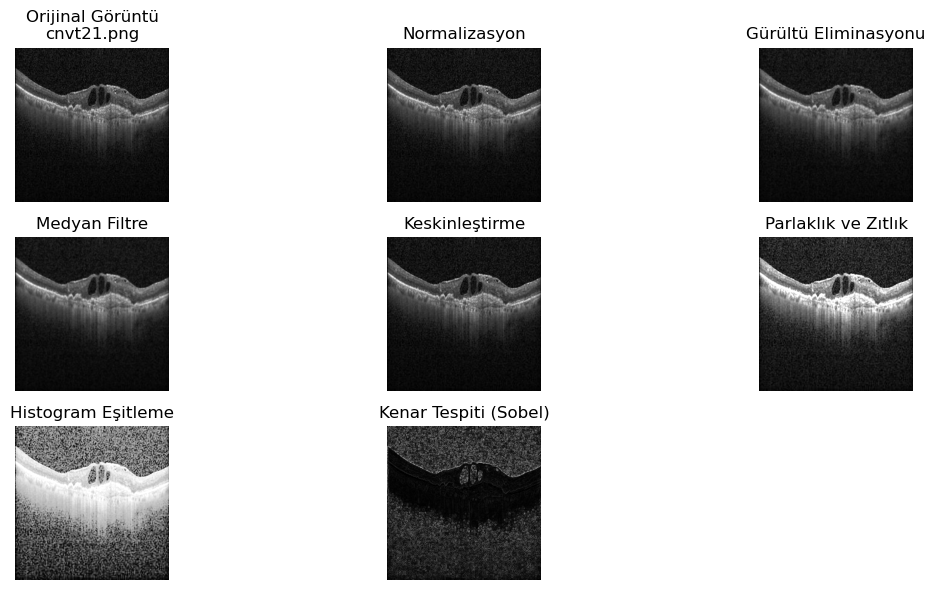

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt21.png
--------------------------------------------------


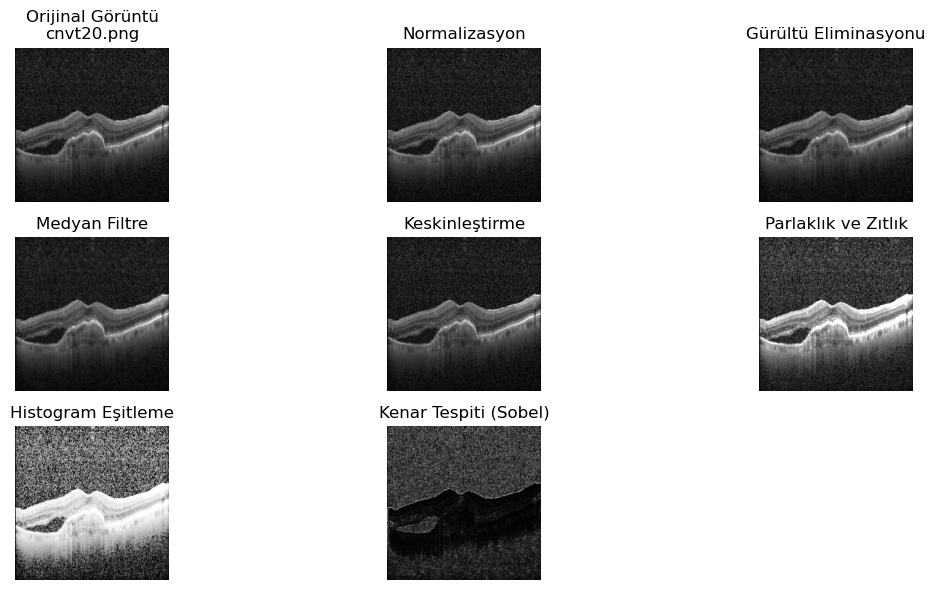

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt20.png
--------------------------------------------------


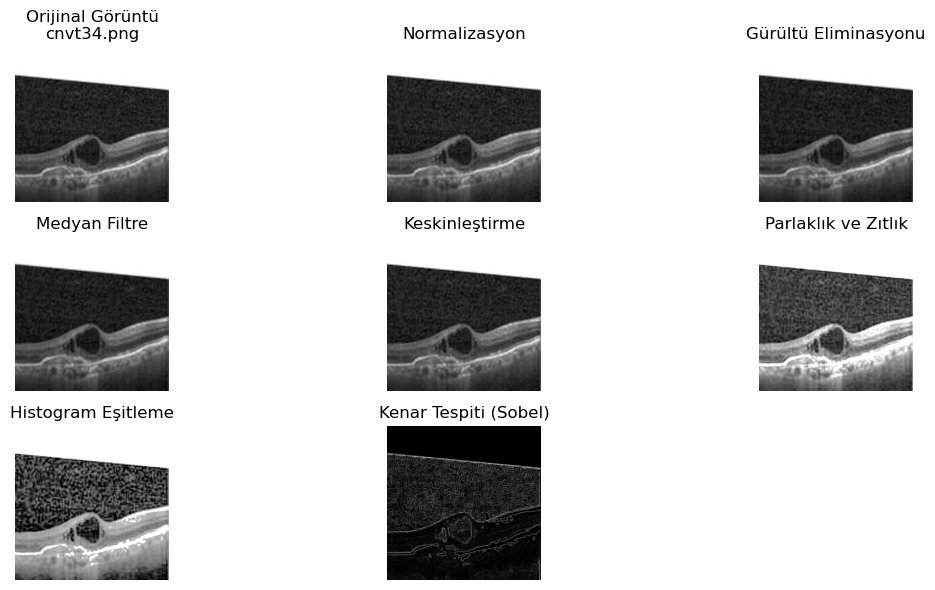

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt34.png
--------------------------------------------------


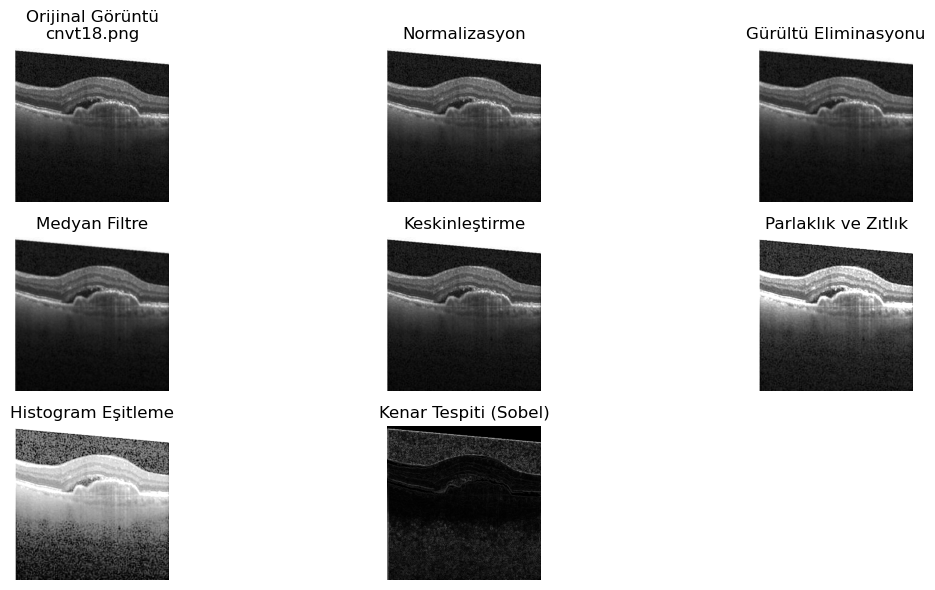

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt18.png
--------------------------------------------------


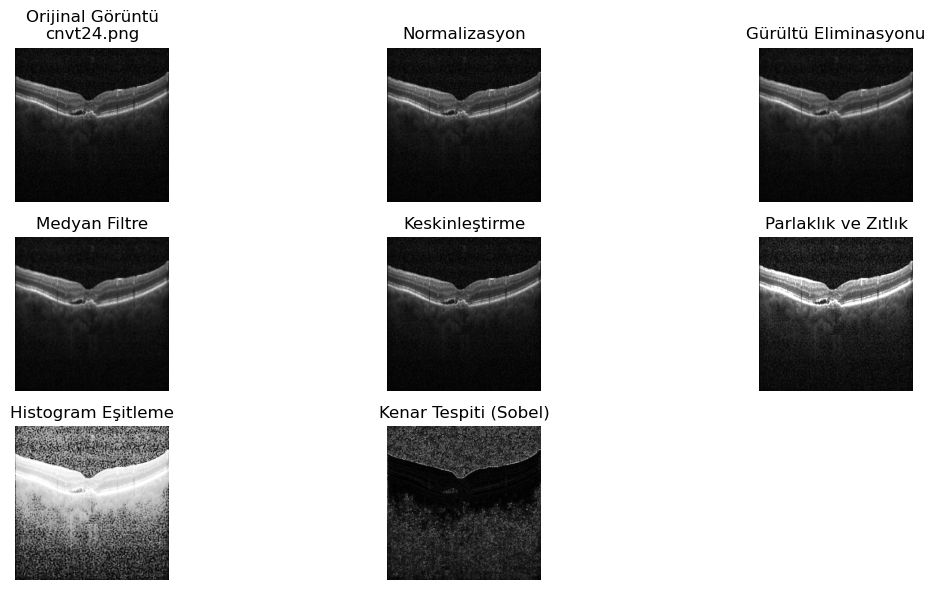

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt24.png
--------------------------------------------------


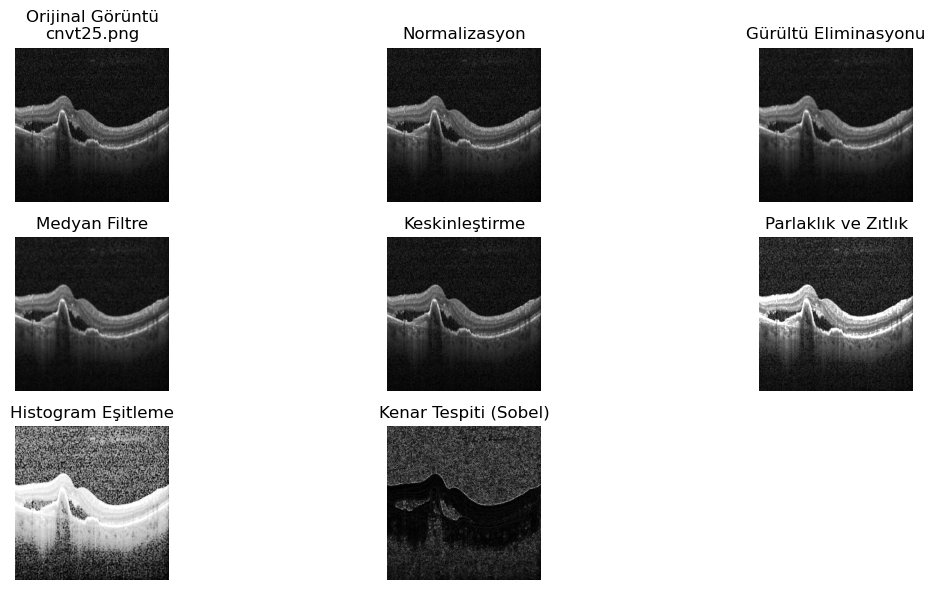

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt25.png
--------------------------------------------------


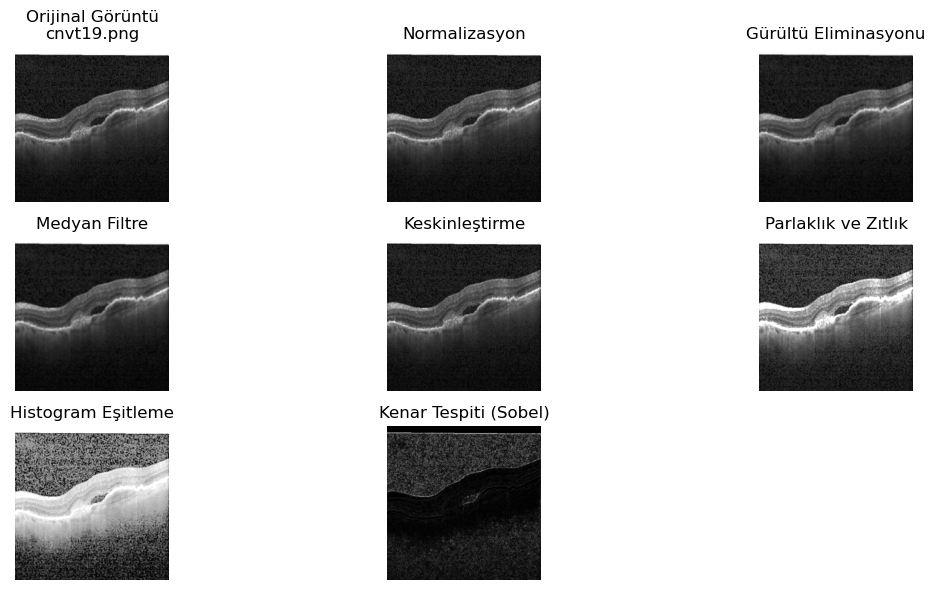

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt19.png
--------------------------------------------------


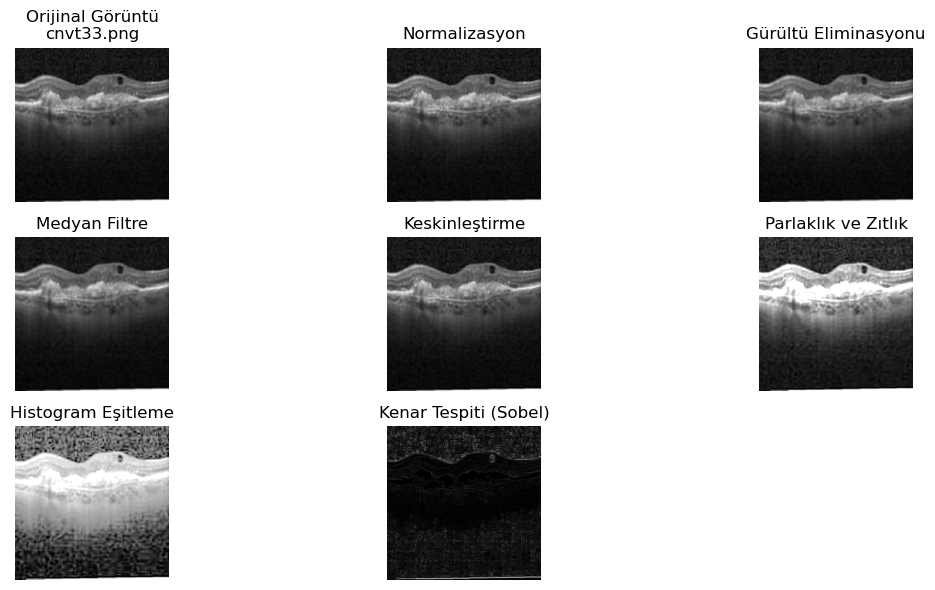

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt33.png
--------------------------------------------------


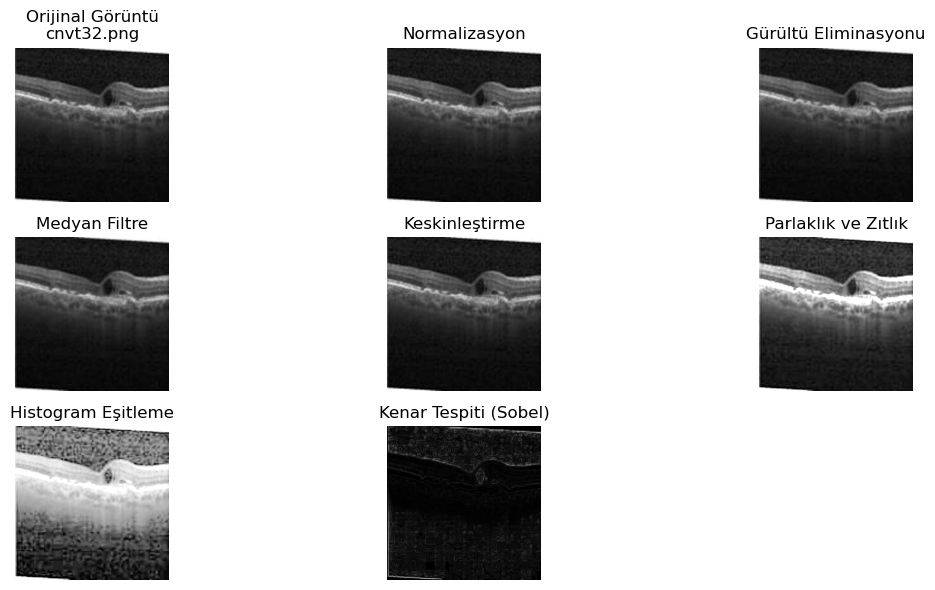

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme/edge_cnvt32.png
--------------------------------------------------
Tüm görseller işlendi ve kaydedildi.


In [175]:
import cv2
import numpy as np
import os
from scipy.ndimage import median_filter
import matplotlib.pyplot as plt

# Giriş ve çıkış klasörleri
input_folder = "/Users/koray/Desktop/24/train/"  # Görsellerin bulunduğu klasör
output_folder = "/Users/koray/Desktop/24/goruntuisleme" # İşlenmiş görsellerin kaydedileceği klasör

# Çıkış klasörü yoksa oluştur
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Görüntüleri işle
for filename in os.listdir(input_folder):
    input_path = os.path.join(input_folder, filename)
    output_path = os.path.join(output_folder, filename)

    # Görüntüyü yükle
    image = cv2.imread(input_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        print(f"Hata: Görüntü '{input_path}' yüklenemedi.")
        continue

    # 1. Normalizasyon (0 ile 255 arasında)
    normalized = cv2.normalize(image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    # 2. Gürültü eliminasyonu (Gaussian Yumuşatma)
    smoothed = cv2.GaussianBlur(normalized, (5, 5), 0)

    # 3. Medyan Filtre
    median_filtered = median_filter(smoothed, size=3)

    # 4. Keskinleştirme (Filtreleme)
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Keskinleştirme filtresi
    sharpened = cv2.filter2D(median_filtered, -1, kernel)

    # 5. Parlaklık ve Zıtlık dönüşümü
    alpha = 1.5  # Parlaklık çarpanı
    beta = 50    # Zıtlık artırıcı
    brightness_contrast = cv2.convertScaleAbs(sharpened, alpha=alpha, beta=beta)

    # 6. Histogram Eşitleme (Kontrast artırma)
    histogram_equalized = cv2.equalizeHist(brightness_contrast)

    # 7. Konvolüsyon (Örnek Kenar Tespiti için Sobel)
    sobel_x = cv2.Sobel(histogram_equalized, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(histogram_equalized, cv2.CV_64F, 0, 1, ksize=3)
    edge_detected = cv2.magnitude(sobel_x, sobel_y)

    # Görselleri birleştirerek göstermek
    plt.figure(figsize=(12, 6))

    # Orijinal Görüntü
    plt.subplot(3, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title(f"Orijinal Görüntü\n{filename}")
    plt.axis('off')

    # Normalizasyon Sonucu
    plt.subplot(3, 3, 2)
    plt.imshow(normalized, cmap='gray')
    plt.title("Normalizasyon")
    plt.axis('off')

    # Gaussian Yumuşatma
    plt.subplot(3, 3, 3)
    plt.imshow(smoothed, cmap='gray')
    plt.title("Gürültü Eliminasyonu")
    plt.axis('off')

    # Medyan Filtre
    plt.subplot(3, 3, 4)
    plt.imshow(median_filtered, cmap='gray')
    plt.title("Medyan Filtre")
    plt.axis('off')

    # Keskinleştirme
    plt.subplot(3, 3, 5)
    plt.imshow(sharpened, cmap='gray')
    plt.title("Keskinleştirme")
    plt.axis('off')

    # Parlaklık ve Zıtlık Ayarı
    plt.subplot(3, 3, 6)
    plt.imshow(brightness_contrast, cmap='gray')
    plt.title("Parlaklık ve Zıtlık")
    plt.axis('off')

    # Histogram Eşitleme
    plt.subplot(3, 3, 7)
    plt.imshow(histogram_equalized, cmap='gray')
    plt.title("Histogram Eşitleme")
    plt.axis('off')

    # Kenar Tespiti
    plt.subplot(3, 3, 8)
    plt.imshow(edge_detected, cmap='gray')
    plt.title("Kenar Tespiti (Sobel)")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    # İşlenmiş görüntüyü kaydet
    output_edge_path = os.path.join(output_folder, f"edge_{filename}")
    cv2.imwrite(output_edge_path, (edge_detected / edge_detected.max() * 255).astype(np.uint8))  # Kenar tespiti sonucu

    print(f"İşlenmiş görüntü kaydedildi: {output_edge_path}")
    print("-" * 50)

print("Tüm görseller işlendi ve kaydedildi.")


İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_1.png


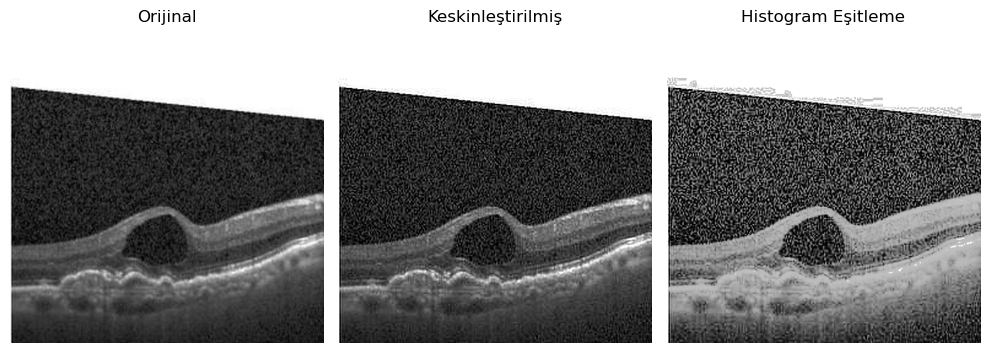

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_2.png


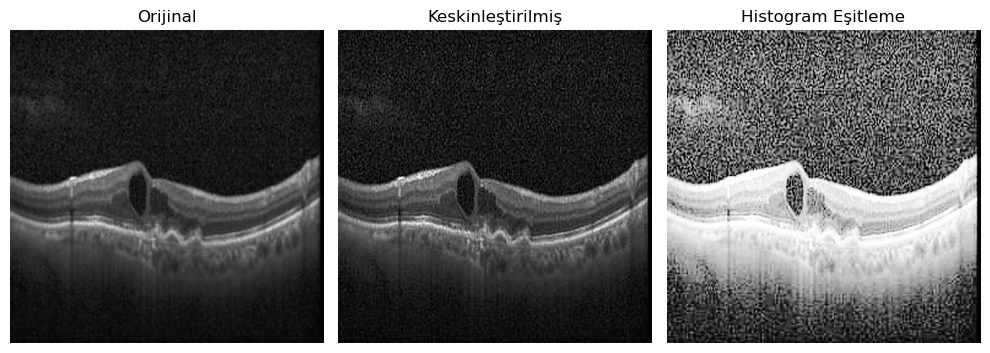

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_3.png


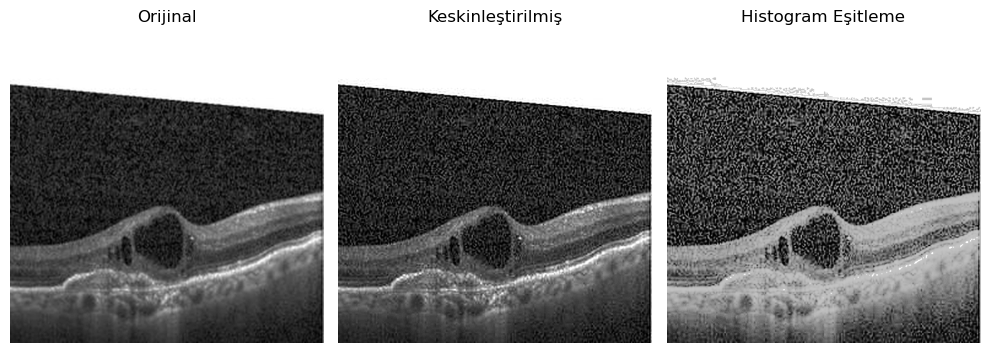

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_4.png


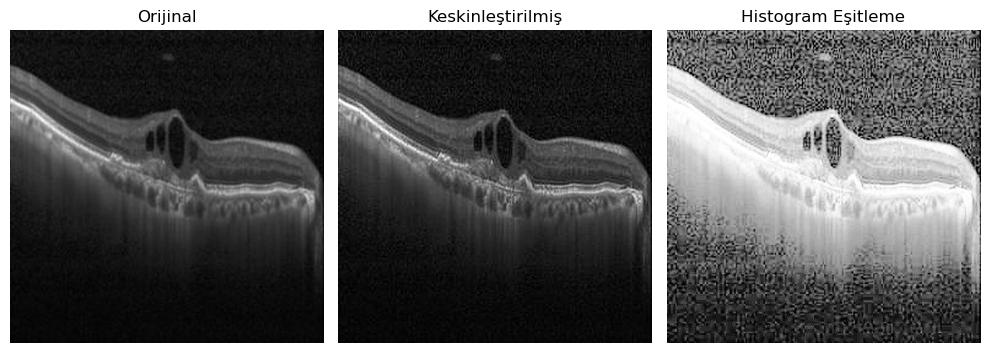

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_5.png


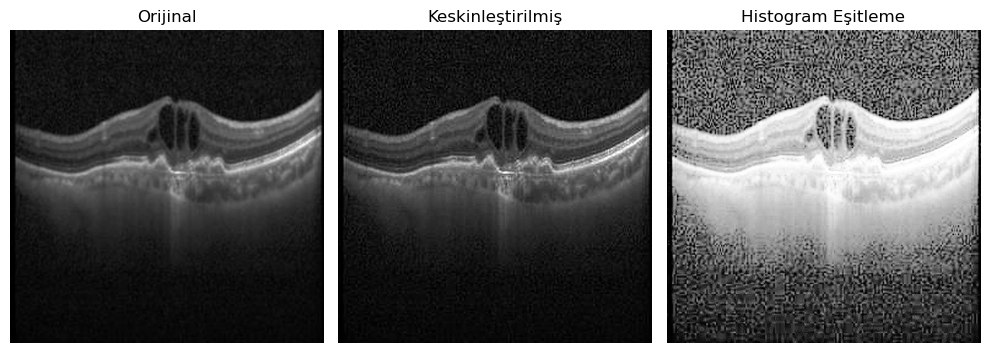

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_6.png


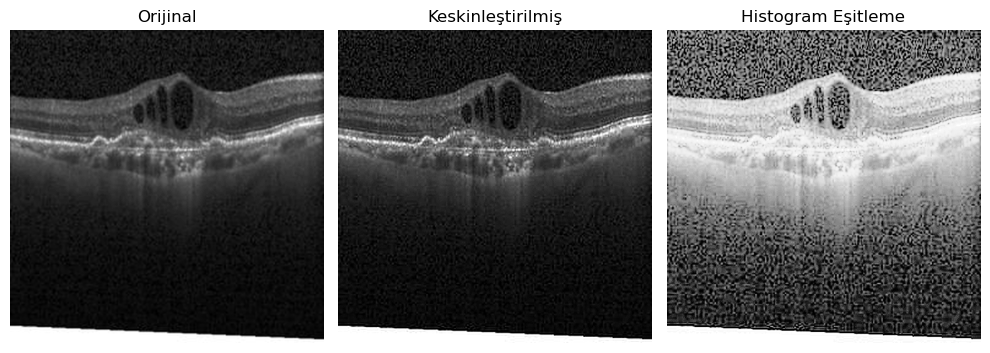

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_7.png


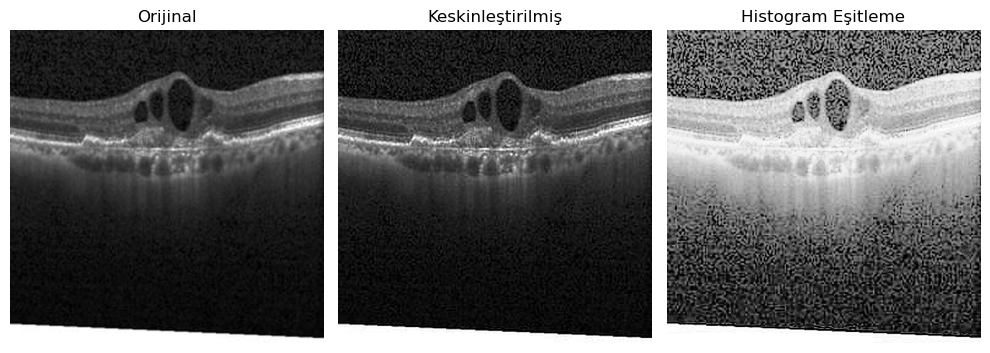

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_8.png


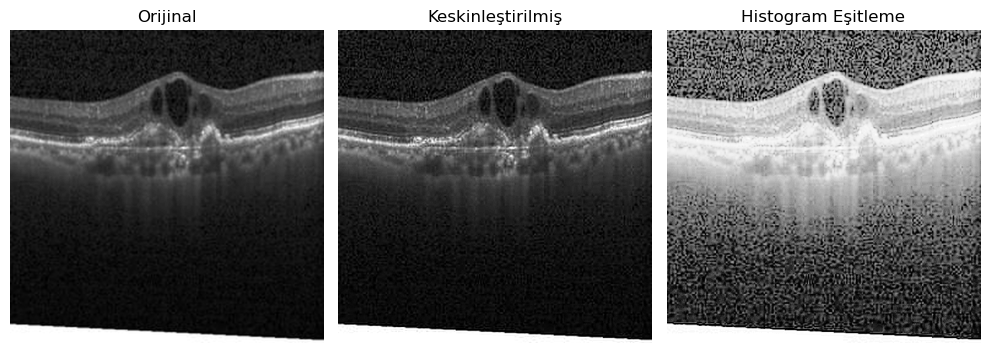

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_9.png


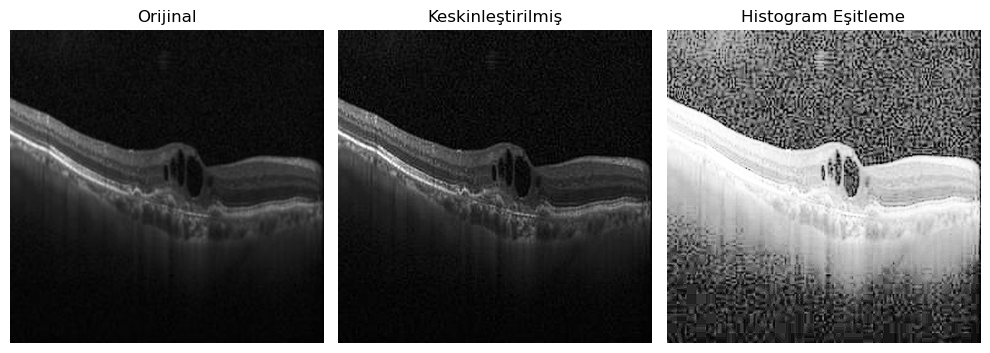

İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/processed_image_10.png


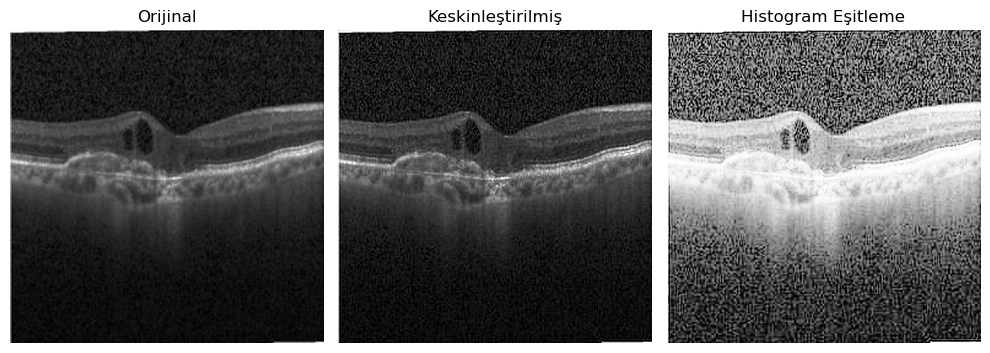

Tüm görüntüler işlendi ve kaydedildi!


In [179]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

# Görüntü dosyalarının yollarını tanımlayın
image_paths = [
    "/Users/koray/Desktop/24/train/cnvt1.png",
    "/Users/koray/Desktop/24/train/cnvt2.png",
    "/Users/koray/Desktop/24/train/cnvt3.png",
    "/Users/koray/Desktop/24/train/cnvt4.png",
    "/Users/koray/Desktop/24/train/cnvt5.png",
    "/Users/koray/Desktop/24/train/cnvt6.png",
    "/Users/koray/Desktop/24/train/cnvt7.png",
    "/Users/koray/Desktop/24/train/cnvt8.png",
    "/Users/koray/Desktop/24/train/cnvt9.png",
    "/Users/koray/Desktop/24/train/cnvt10.png",
]

# İşlenmiş görüntülerin kaydedileceği klasör
output_folder = "/Users/koray/Desktop/24/goruntuisleme1"  # İşlenmiş görsellerin kaydedileceği klasör

# Çıkış klasörü yoksa oluştur
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Görüntü işleme
for idx, path in enumerate(image_paths):
    output_path = os.path.join(output_folder, f"processed_image_{idx+1}.png")
    
    # Görüntüyü yükle
    image = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        print(f"Hata: Görüntü '{path}' yüklenemedi.")
        continue

    # 1. Keskinleştirme
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    sharpened = cv2.filter2D(image, -1, kernel)

    # 2. Histogram Eşitleme
    equalized = cv2.equalizeHist(sharpened)

    # İşlenmiş görüntüyü kaydet
    cv2.imwrite(output_path, equalized)
    print(f"İşlenmiş görüntü kaydedildi: {output_path}")

    # Görselleştirme (isteğe bağlı)
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Orijinal")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(sharpened, cmap='gray')
    plt.title("Keskinleştirilmiş")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(equalized, cmap='gray')
    plt.title("Histogram Eşitleme")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

print("Tüm görüntüler işlendi ve kaydedildi!")


In [3]:
import cv2
import numpy as np
import os

# Görüntü ve label dosyalarının yolları
image_paths = [
    "/Users/koray/Desktop/24/train/cnvt1.png",
    "/Users/koray/Desktop/24/train/cnvt2.png",
    "/Users/koray/Desktop/24/train/cnvt3.png",
    "/Users/koray/Desktop/24/train/cnvt4.png",
    "/Users/koray/Desktop/24/train/cnvt5.png",
    "/Users/koray/Desktop/24/train/cnvt6.png",
    "/Users/koray/Desktop/24/train/cnvt7.png",
    "/Users/koray/Desktop/24/train/cnvt8.png",
    "/Users/koray/Desktop/24/train/cnvt9.png",
    "/Users/koray/Desktop/24/train/cnvt10.png",
]
mask_paths = [
    "/Users/koray/Desktop/24/label/label1.png",
    "/Users/koray/Desktop/24/label/label2.png",
    "/Users/koray/Desktop/24/label/label3.png",
    "/Users/koray/Desktop/24/label/label4.png",
    "/Users/koray/Desktop/24/label/label5.png",
    "/Users/koray/Desktop/24/label/label6.png",
    "/Users/koray/Desktop/24/label/label7.png",
    "/Users/koray/Desktop/24/label/label8.png",
    "/Users/koray/Desktop/24/label/label9.png",
    "/Users/koray/Desktop/24/label/label10.png",
]
# İşlenmiş görüntülerin kaydedileceği klasör
output_folder ="/Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu"# Yerel bir klasör
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# İşleme adımları
for image_path, mask_path in zip(image_paths, mask_paths):
    # Görüntü ve label yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

    if image is None or mask is None:
        print(f"Hata: '{image_path}' veya '{mask_path}' yüklenemedi.")
        continue

    # 1. Keskinleştirme filtresi
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    sharpened = cv2.filter2D(image, -1, kernel)

    # 2. Histogram eşitleme
    equalized = cv2.equalizeHist(sharpened)

    # Sadece mask içindeki bölgeyi işleme uygula
    processed_image = image.copy()
    processed_image[mask == 255] = equalized[mask == 255]

    # İşlenmiş görüntüyü kaydet
    base_name = os.path.basename(image_path)
    new_file_name = f"processed_{base_name}"
    output_path = os.path.join(output_folder, new_file_name)
    cv2.imwrite(output_path, processed_image)
    print(f"İşlenmiş görüntü kaydedildi: {output_path}")

print("Tüm görüntüler işlendi ve kaydedildi!")


İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt1.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt2.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt3.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt4.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt5.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt6.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt7.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt8.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisleme1/islenmisgoruntu/processed_cnvt9.png
İşlenmiş görüntü kaydedildi: /Users/koray/Desktop/24/goruntuisle

### Canny Kenar Algılama

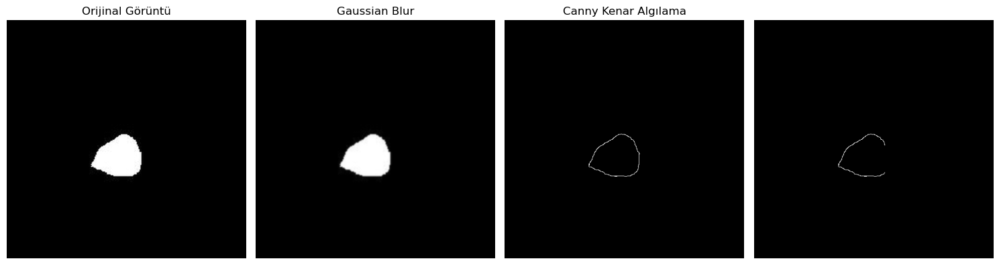

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü yükleme
image_path = "/Users/koray/Desktop/24/label/label1.png"  # Görüntü yolunu güncelleyin
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Gaussian bulanıklaştırma (gürültü azaltmak için)
blurred_image = cv2.GaussianBlur(image, (5, 5), 0)

# Canny kenar algılama (parametreleri iyileştir)
edges_canny = cv2.Canny(blurred_image, threshold1=30, threshold2=100)

# Morfolojik işlemler (kenarları iyileştirmek için)
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
dilated_edges = cv2.dilate(edges_canny, kernel, iterations=1)  # Kenarları genişlet
eroded_edges = cv2.erode(dilated_edges, kernel, iterations=1)  # Fazlalıkları temizle

# Omurilik alanını çıkarmak için maskeyi güncelleyin
mask = np.zeros_like(eroded_edges)
mask[30:400, 80:280] = 255  # Daha geniş bir alan belirleyin (resme göre ayarlayın)

# Maskeyi kenar algılama sonucu ile çarpma
spine_edges = cv2.bitwise_and(eroded_edges, mask)

# Görüntüleri görselleştirme
plt.figure(figsize=(15, 5))

plt.subplot(1, 4, 1)
plt.title("Orijinal Görüntü")
plt.imshow(image, cmap="gray")
plt.axis("off")

plt.subplot(1, 4, 2)
plt.title("Gaussian Blur")
plt.imshow(blurred_image, cmap="gray")
plt.axis("off")

plt.subplot(1, 4, 3)
plt.title("Canny Kenar Algılama")
plt.imshow(eroded_edges, cmap="gray")
plt.axis("off")

plt.subplot(1, 4, 4)
plt.imshow(spine_edges, cmap="gray")
plt.axis("off")

plt.tight_layout()
plt.show()


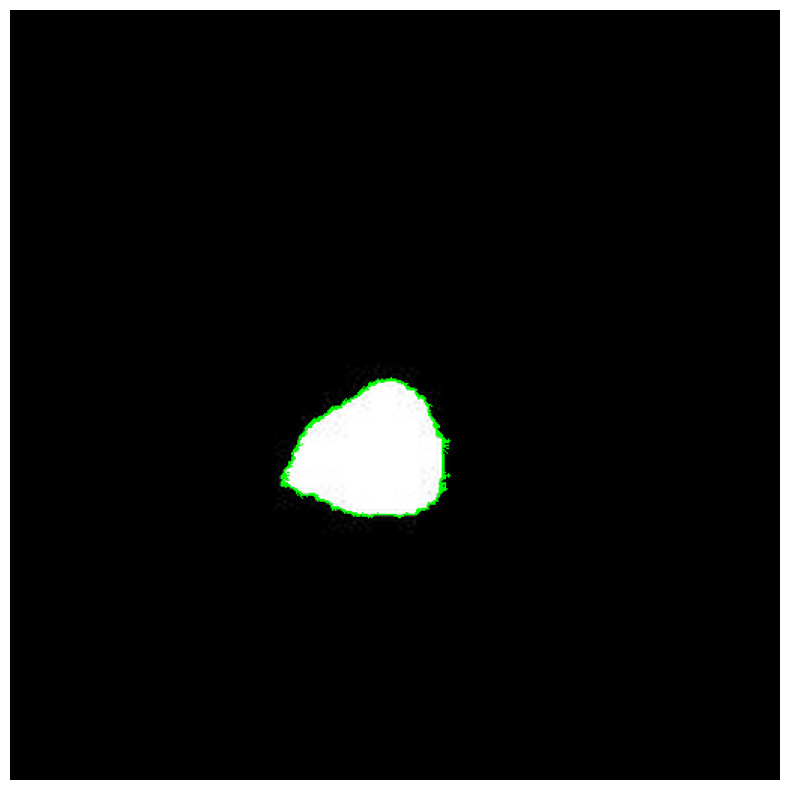

In [220]:
import cv2
import numpy as np
import math
import matplotlib.pyplot as plt

# Görüntüyü yükle ve kenarları bul
label_img = cv2.imread("/Users/koray/Desktop/24/label/label1.png", cv2.IMREAD_GRAYSCALE)
edges = cv2.Canny(label_img, 100, 200)

# Gaussian bulanıklaştırma
blurred_image = cv2.GaussianBlur(edges, (5, 5), 0)

# Sobel gradyanlarını hesaplayarak yönleri belirleyin
sobel_x = cv2.Sobel(blurred_image, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(blurred_image, cv2.CV_64F, 0, 1, ksize=3)

# Açıyı hesaplayın ve ortalama alarak yönleri düzenleyin
angles = np.arctan2(sobel_y, sobel_x)
smoothed_angles = cv2.blur(angles, (5, 5))  # Ortalama ile düzgünleştirme

# Çizgileri çizmek için renkli bir görüntü oluşturun
output_image = cv2.cvtColor(label_img, cv2.COLOR_GRAY2BGR)

# Çizgileri daha düzgün hale getirmek için her kenar noktasında çizgi çizin
length = 5
for y in range(edges.shape[0]):
    for x in range(edges.shape[1]):
        if edges[y, x]:  # Kenar noktasındaysa
            angle = smoothed_angles[y, x]
            dx = int(length * math.cos(angle))
            dy = int(length * math.sin(angle))
            x1, y1 = x, y
            x2, y2 = x + dx, y + dy
            cv2.line(output_image, (x1, y1), (x2, y2), (0, 255, 0), 1)  # Çizgiyi yeşil çiziyoruz

# Görselleştirme
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


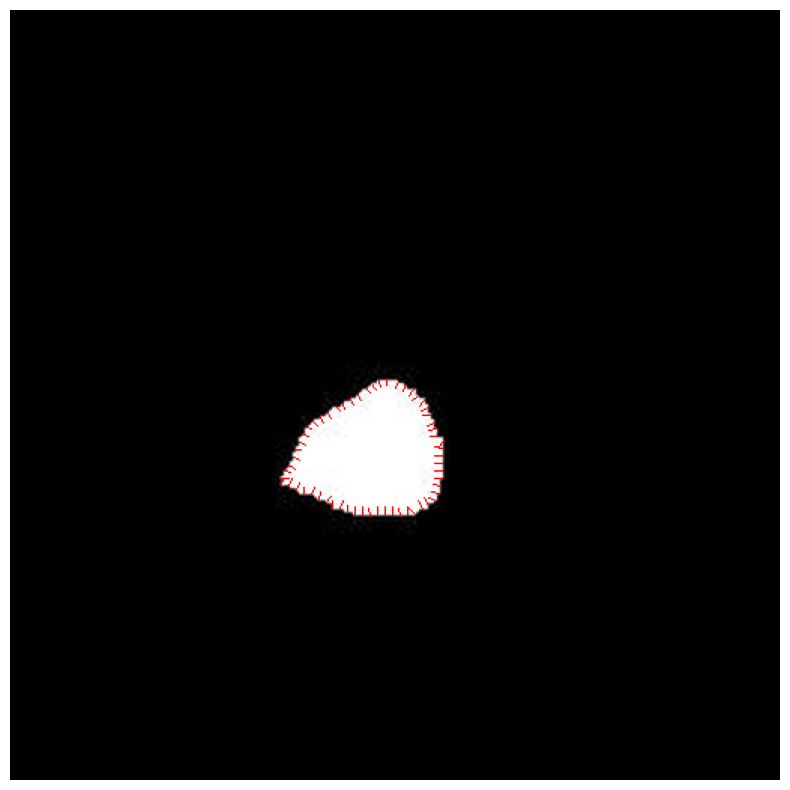

In [241]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import math

# Görüntüyü yükle ve gri tonlamaya çevir
image_path = "/Users/koray/Desktop/24/label/label1.png"  # Görüntü dosyanızın yolunu buraya ekleyin
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Kenarları bulmak için Canny kenar algılama
edges = cv2.Canny(image, 100, 200)

# Kontur bul
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
contour = max(contours, key=cv2.contourArea)  # En büyük konturu seçiyoruz

# Çizgileri çizeceğimiz yeni bir renkli görüntü oluştur
output_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)

# Seyreklik faktörü (her kaçıncı noktadan bir çizgi çizileceğini belirler)
sparsity_factor = 5
line_length = 5  # Çizgi uzunluğu (içeri doğru daha kısa çizgiler için)

# Her kontur noktası boyunca kenar yönünde çizgiler çiz
for i in range(0, len(contour), sparsity_factor):
    x, y = contour[i][0]
    
    # Kenar yönelimini hesaplamak için komşu bir sonraki noktayı seç
    if i + sparsity_factor < len(contour):
        x_next, y_next = contour[i + sparsity_factor][0]
    else:
        break  # Son noktaya ulaşıldığında döngüyü bitir

    # İki nokta arasındaki vektörün yön açısını bul
    dx = x_next - x
    dy = y_next - y
    angle = math.atan2(dy, dx)  # Açıyı hesapla

    # Çizginin başlangıç ve bitiş noktalarını hesapla (kenarın iç tarafına göre)
    perp_angle = angle + math.pi / 2  # Kenara dik açı ve içeri yönlü
    x_start, y_start = x, y
    x_end = int(x_start - line_length * math.cos(perp_angle))  # İçeriye yönlü
    y_end = int(y_start - line_length * math.sin(perp_angle))  # İçeriye yönlü

    # Çizgiyi çiz
    cv2.line(output_image, (x_start, y_start), (x_end, y_end), (0, 0, 255), 1)

# Sonucu görselleştir
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


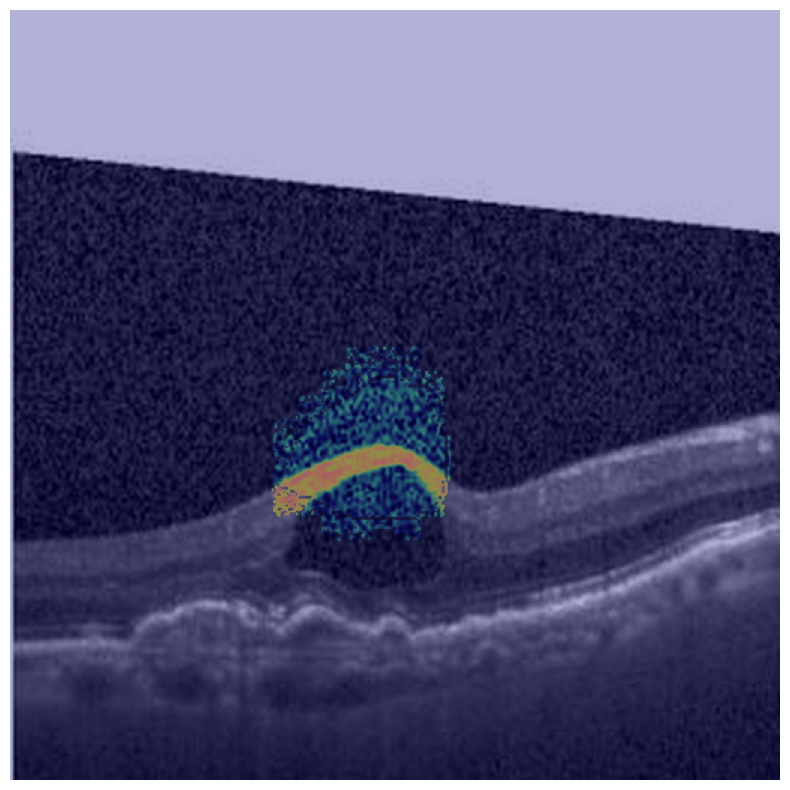

In [245]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage import measure

class RontgenModelleyici:
    def __init__(self, goruntu_yolu, etiket_yolu):
        # Görüntü ve etiket yüklemesi
        self.goruntu = cv2.imread(goruntu_yolu, cv2.IMREAD_GRAYSCALE)
        self.etiket = cv2.imread(etiket_yolu, cv2.IMREAD_GRAYSCALE)
        
        if self.goruntu is None or self.etiket is None:
            raise FileNotFoundError("Görüntü veya etiket dosyası yüklenemedi. Lütfen yolları kontrol edin.")
        
    def label_piksellerini_getir(self):
        # Label'a ait pikselleri bulma (A)
        a_pikseller = self.goruntu[self.etiket > 0]
        return a_pikseller
    
    def dw_dist_hesapla(self, piksel_degerleri):
        # DW dist hesaplaması (B)
        dw_dist = measure.shannon_entropy(piksel_degerleri)
        return dw_dist
    
    def onem_vektoru_hesapla(self):
        # A piksellerini getir
        a = self.label_piksellerini_getir()
        
        # DW dist hesapla
        b = self.dw_dist_hesapla(a)
        
        # Önem vektörü hesaplama (D = A * B)
        d = np.multiply(a, b)
        
        return d

    def modelleme_sonucu_gorsellestir(self):
        # Önem vektörü hesapla
        onem_vektoru = self.onem_vektoru_hesapla()
        
        # Görüntü boyutlarına uygun maske oluştur
        maske = np.zeros_like(self.goruntu, dtype=np.float32)
        maske[self.etiket > 0] = onem_vektoru
        
        # Maskeyi normalize et
        maske = cv2.normalize(maske, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
        maske = maske.astype(np.uint8)
        
        # Maskeyi renkli hale getir
        renkli_maske = cv2.applyColorMap(maske, cv2.COLORMAP_JET)
        
        # Röntgen ve maskeyi birleştir
        goruntu_renkli = cv2.cvtColor(self.goruntu, cv2.COLOR_GRAY2BGR)
        sonuc = cv2.addWeighted(goruntu_renkli, 0.7, renkli_maske, 0.3, 0)
        
        # Sonucu döndür
        return sonuc

# Kullanım örneği
model = RontgenModelleyici(
    "/Users/koray/Desktop/24/train/cnvt1.png" ,
    "/Users/koray/Desktop/24/label/label1.png" 
)

sonuc_goruntu = model.modelleme_sonucu_gorsellestir()

# Görselleştirme
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(sonuc_goruntu, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()


### Sobel Kenar Algılama

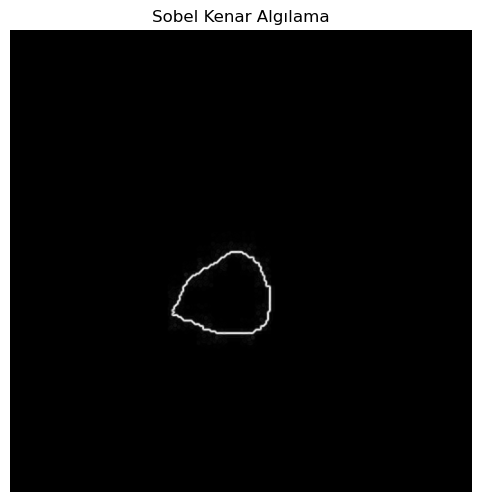

In [188]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Dosya yolunuzu buraya ekliyoruz
image_path = "/Users/koray/Desktop/24/label/label1.png"

# Görüntüyü yükleme
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Sobel kenar algılama
sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
sobel_edges = cv2.magnitude(sobel_x, sobel_y)

# Sobel kenar algılamayı görüntüleme
plt.figure(figsize=(6, 6))
plt.imshow(sobel_edges, cmap='gray')
plt.title("Sobel Kenar Algılama")
plt.axis('off')
plt.show()

### Canny Kenar Algılama

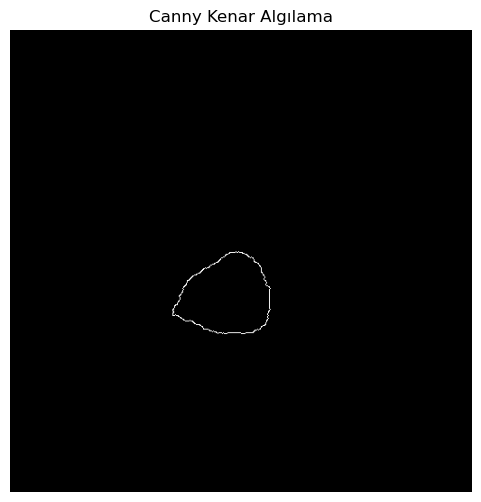

In [190]:
# Canny kenar algılama
canny_edges = cv2.Canny(image, 100, 200)

# Canny kenar algılamayı görüntüleme
plt.figure(figsize=(6, 6))
plt.imshow(canny_edges, cmap='gray')
plt.title("Canny Kenar Algılama")
plt.axis('off')
plt.show()

### Laplacian Kenar Algılama

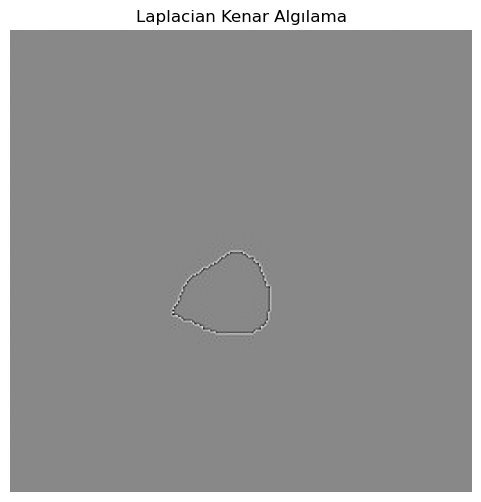

In [192]:
# Laplacian kenar algılama
laplacian_edges = cv2.Laplacian(image, cv2.CV_64F)

# Laplacian kenar algılamayı görüntüleme
plt.figure(figsize=(6, 6))
plt.imshow(laplacian_edges, cmap='gray')
plt.title("Laplacian Kenar Algılama")
plt.axis('off')
plt.show()

### Entropi (Görüntü Entropisi)

In [195]:
# Entropi hesaplama
def calculate_entropy(image):
    hist = cv2.calcHist([image], [0], None, [256], [0, 256])
    hist /= hist.sum()
    entropy = -np.sum(hist * np.log2(hist + 1e-6))  # Küçük bir epsilon ekleyerek log(0) hatasını engelliyoruz
    return entropy

# Entropi hesaplamak
entropy_value = calculate_entropy(image)
print("Görüntü Entropisi:", entropy_value)

Görüntü Entropisi: 0.39628375


### Range (Görüntüdeki Piksel Değeri Aralığı)

In [198]:
range_value = np.ptp(image)  # Peak-to-Peak (En yüksek ve en düşük değer arasındaki fark)
print("Görüntü Range (Piksel Değeri Aralığı):", range_value)

Görüntü Range (Piksel Değeri Aralığı): 255


### Standart Sapma (Std)

In [201]:
# Standart Sapma hesaplama
std_dev = np.std(image)
print("Görüntü Standart Sapma (Std):", std_dev)

Görüntü Standart Sapma (Std): 40.47877279639371


###   BRISQUE Skoru ile Görüntü Kalitesini Değerlendirme ( Kenar Algılama, Entropi Hesaplama, Range, Standart Sapma 
### Hata verdiği  için scikit-image ile SSIM Kullanıldı

In [247]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

# Görüntüyü yükle
image_path = "/Users/koray/Desktop/24/label/label1.png"
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# SSIM hesaplama fonksiyonu
def calculate_ssim(original, processed):
    score, _ = ssim(original, processed, full=True)
    return score

# 1. Sobel Kenar Algılama
sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
sobel_edge = cv2.magnitude(sobel_x, sobel_y)

# SSIM ile değerlendirme
sobel_ssim_score = calculate_ssim(image, sobel_edge.astype(np.uint8))
print(f"Sobel Kenar Algılama Sonrası SSIM Skoru: {sobel_ssim_score:.4f}")

# 2. Canny Kenar Algılama
canny_edges = cv2.Canny(image, 100, 200)

# SSIM ile değerlendirme
canny_ssim_score = calculate_ssim(image, canny_edges)
print(f"Canny Kenar Algılama Sonrası SSIM Skoru: {canny_ssim_score:.4f}")

# 3. Laplacian Kenar Algılama
laplacian_edges = cv2.Laplacian(image, cv2.CV_64F)

# SSIM ile değerlendirme
laplacian_ssim_score = calculate_ssim(image, laplacian_edges.astype(np.uint8))
print(f"Laplacian Kenar Algılama Sonrası SSIM Skoru: {laplacian_ssim_score:.4f}")

# 4. Entropi Hesaplama
def calculate_entropy(image):
    hist = cv2.calcHist([image], [0], None, [256], [0, 256])
    hist = hist / hist.sum()  # normalize
    entropy = -np.sum(hist * np.log2(hist + 1e-10))  # avoid log(0)
    return entropy

entropy_value = calculate_entropy(image)
print(f"Görüntü Entropisi: {entropy_value:.4f}")

# 5. Range (Piksel Değeri Aralığı) Hesaplama
range_value = np.ptp(image)  # Peak-to-peak (range) değerini hesaplama
print(f"Görüntü Range (Piksel Değeri Aralığı): {range_value}")

# 6. Standart Sapma Hesaplama
std_value = np.std(image)
print(f"Görüntü Standart Sapma (Std): {std_value:.4f}")

Sobel Kenar Algılama Sonrası SSIM Skoru: 0.9538
Canny Kenar Algılama Sonrası SSIM Skoru: 0.9621
Laplacian Kenar Algılama Sonrası SSIM Skoru: 0.9508
Görüntü Entropisi: 0.3966
Görüntü Range (Piksel Değeri Aralığı): 255
Görüntü Standart Sapma (Std): 40.4788


### Pipeline1 (I1norm + Median + HistEq)

In [249]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

# SSIM hesaplama fonksiyonu
def calculate_ssim(original, processed):
    score, _ = ssim(original, processed, full=True)
    return score

# Görüntü yükleme
image_path = "/Users/koray/Desktop/24/label/label1.png"
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# 1. I1norm (Normalization)
i1norm_image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)

# 2. Median Filter
median_image = cv2.medianBlur(i1norm_image, 5)

# 3. Histogram Equalization
hist_eq_image = cv2.equalizeHist(median_image)

# SSIM ile değerlendirme (Pipeline1 Sonucu ile Orijinal Karşılaştırma)
pipeline1_ssim_score = calculate_ssim(image, hist_eq_image)
print(f"Pipeline1 (I1norm + Median + HistEq) SSIM Skoru: {pipeline1_ssim_score:.4f}")

Pipeline1 (I1norm + Median + HistEq) SSIM Skoru: 0.9662


### Pipeline2 (MinmaxNorm + Mean + Gamma)

In [210]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

# SSIM hesaplama fonksiyonu
def calculate_ssim(original, processed):
    score, _ = ssim(original, processed, full=True)
    return score

# Görüntü yükleme
image_path = "/Users/koray/Desktop/24/train/cnvt1.png"
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# 1. Minmax Normalization
minmax_image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)

# 2. Mean Filter
mean_image = cv2.blur(minmax_image, (5, 5))

# 3. Gamma Correction
gamma = 1.5
gamma_image = np.array(255 * (minmax_image / 255) ** gamma, dtype='uint8')

# SSIM ile değerlendirme (Pipeline2 Sonucu ile Orijinal Karşılaştırma)
pipeline2_ssim_score = calculate_ssim(image, gamma_image)
print(f"Pipeline2 (MinmaxNorm + Mean + Gamma) SSIM Skoru: {pipeline2_ssim_score:.4f}")

Pipeline2 (MinmaxNorm + Mean + Gamma) SSIM Skoru: 0.7622


### Desen Kodla
### 1. Organ Görüntüsü İşleme
###	Hedef organın görünmesi için sadece organ bölgesini maskeleyerek çıkardık
###	Maskeyi görüntü ve label çarpımıyla oluşturduk

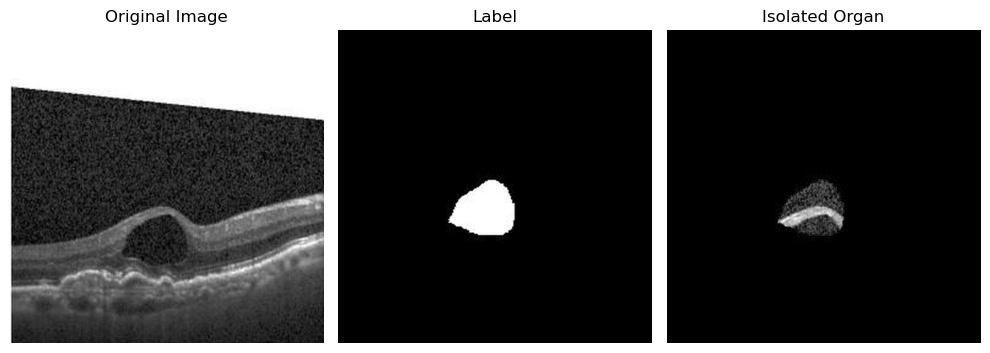

In [73]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 1. Aşama: Görüntü ve etiket çarpımıyla organı izole et
def isolate_organ(image_path, label_path):
    # Görüntü ve etiket yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    
    # Organı izole etmek için piksel bazında çarpma işlemi
    isolated_organ = cv2.bitwise_and(image, label)
    
    # Görüntüleme
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("Label")
    plt.imshow(label, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title("Isolated Organ")
    plt.imshow(isolated_organ, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()
    
    return isolated_organ

# Örnek çağrı
isolated_organ = isolate_organ('/Users/koray/Desktop/24/train/cnvt1.png', '/Users/koray/Desktop/24/label/label1.png')

### 2. Anahtar Nokta Tespiti
### SIFT, ORB veya AKAZE kullanılarak anahtar noktaları bulduk

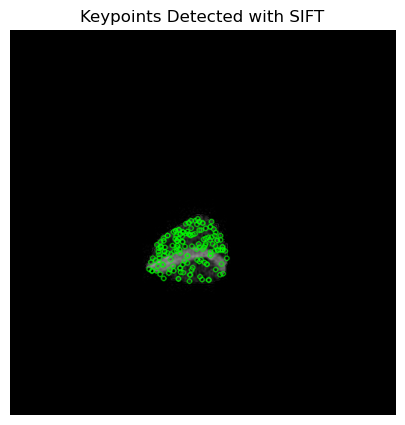

In [76]:
# 2. Aşama: SIFT ile anahtar nokta tespiti
def detect_keypoints(image, method="SIFT"):
    if method == "SIFT":
        detector = cv2.SIFT_create()
    elif method == "ORB":
        detector = cv2.ORB_create()
    elif method == "AKAZE":
        detector = cv2.AKAZE_create()
    else:
        raise ValueError("Unknown method. Choose 'SIFT', 'ORB', or 'AKAZE'")
    
    # Anahtar noktaları ve açıklayıcıları bul
    keypoints, descriptors = detector.detectAndCompute(image, None)

    # Anahtar noktaları çiz
    keypoint_image = cv2.drawKeypoints(image, keypoints, None, color=(0, 255, 0))
    
    # Görüntüleme
    plt.figure(figsize=(10, 5))
    plt.title(f"Keypoints Detected with {method}")
    plt.imshow(keypoint_image)
    plt.axis('off')
    plt.show()
    
    return keypoints, descriptors

# Örnek çağrı
keypoints, descriptors = detect_keypoints(isolated_organ, method="SIFT")

### 3. Desen Kodlama (HoG, CoHoG, LBP)

In [79]:
from skimage.feature import hog

# 3. Aşama: HoG kullanarak desen kodlama
def encode_pattern(image, keypoints, patch_size=32):
    descriptors = []
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])  # Anahtar nokta koordinatları

        # Patch sınırlarını kontrol et
        x_start, x_end = max(0, x - patch_size // 2), min(image.shape[1], x + patch_size // 2)
        y_start, y_end = max(0, y - patch_size // 2), min(image.shape[0], y + patch_size // 2)

        # Yama al ve HoG hesapla
        patch = image[y_start:y_end, x_start:x_end]
        if patch.size > 0:
            hog_descriptor = hog(patch, pixels_per_cell=(8, 8), cells_per_block=(2, 2), feature_vector=True)
            descriptors.append(hog_descriptor)

    print(f"{len(descriptors)} descriptors generated.")
    return np.array(descriptors)

# Örnek çağrı
pattern_descriptors = encode_pattern(isolated_organ, keypoints)

155 descriptors generated.


### 4. Test Görsellerini İşleme

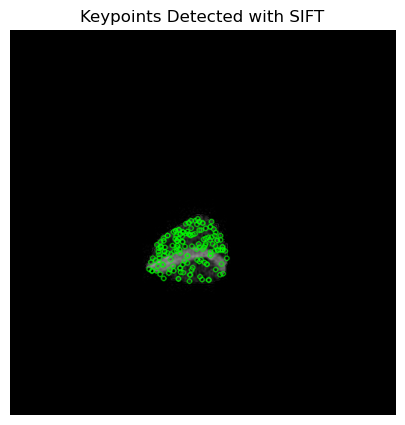

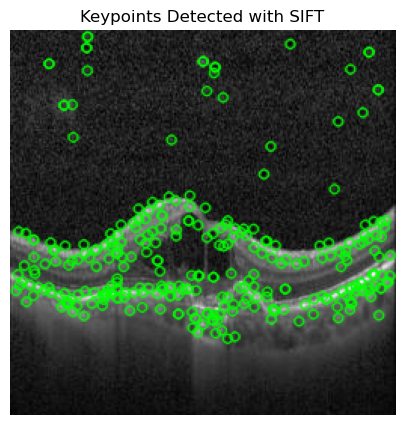

Test descriptors shape: (296, 128)
Train descriptors shape: (155, 128)
Test descriptors range: min=0.0, max=0.3961844742298126
Train descriptors range: min=0.0, max=0.3733596205711365
54 good matches found.


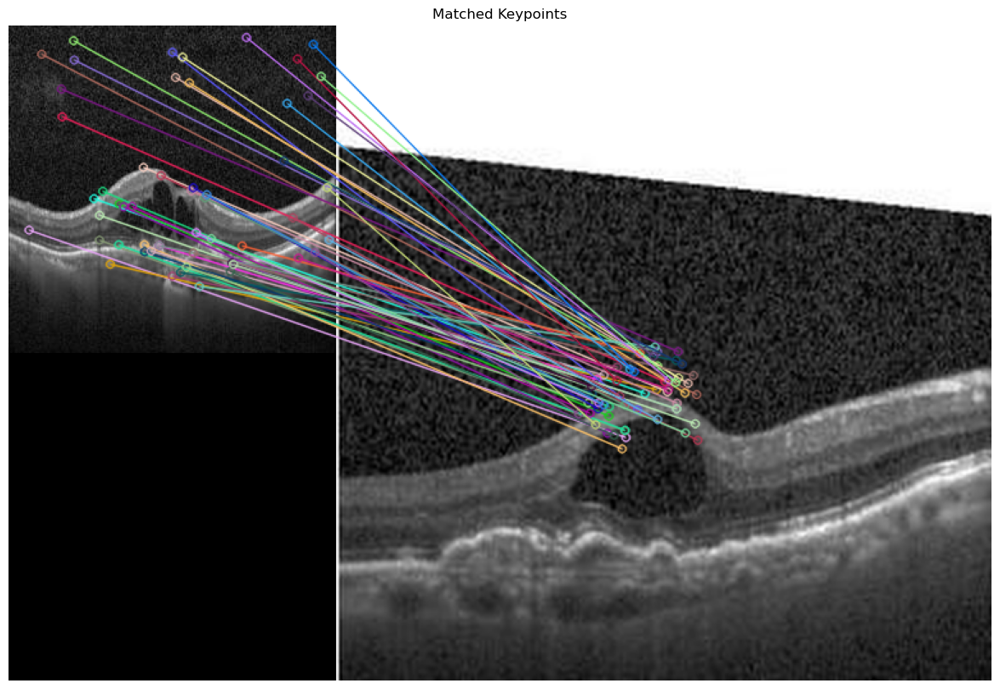

In [82]:
def process_test_image(test_image_path, train_descriptors, threshold=1.0):
    test_image = cv2.imread(test_image_path, cv2.IMREAD_GRAYSCALE)
    test_keypoints, test_descriptors = detect_keypoints(test_image, method="SIFT")

    # Descriptor kontrolü
    if test_descriptors is None or len(test_descriptors) == 0:
        raise ValueError("Test descriptors are empty. Ensure the test image has sufficient keypoints.")
    if train_descriptors is None or len(train_descriptors) == 0:
        raise ValueError("Train descriptors are empty. Ensure the train image has sufficient keypoints.")

    # Descriptor türlerini eşitle ve normalize et
    train_descriptors = np.float32(train_descriptors)
    test_descriptors = np.float32(test_descriptors)

    train_descriptors /= np.linalg.norm(train_descriptors, axis=1, keepdims=True)
    test_descriptors /= np.linalg.norm(test_descriptors, axis=1, keepdims=True)

    # Descriptor boyutlarını kontrol et
    print(f"Test descriptors shape: {test_descriptors.shape}")
    print(f"Train descriptors shape: {train_descriptors.shape}")
    print(f"Test descriptors range: min={test_descriptors.min()}, max={test_descriptors.max()}")
    print(f"Train descriptors range: min={train_descriptors.min()}, max={train_descriptors.max()}")

    # BF eşleştirici ile eşleşmeleri bul
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    matches = bf.match(test_descriptors, train_descriptors)

    # Benzerlik eşik değerine göre filtreleme
    good_matches = [m for m in matches if m.distance < threshold]

    print(f"{len(good_matches)} good matches found.")

    # Eşleşmeleri görselleştir
    matched_image = cv2.drawMatches(
        cv2.imread(test_image_path), test_keypoints,
        cv2.imread('/Users/koray/Desktop/24/train/cnvt1.png'), train_keypoints,
        matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
    )

    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title("Matched Keypoints")
    plt.show()

    return good_matches

# Train için descriptorları yeniden oluştur
train_keypoints, train_descriptors = detect_keypoints(isolated_organ, method="SIFT")

# Örnek çağrı
test_matches = process_test_image('/Users/koray/Desktop/24/test/cnvt45.jpeg', train_descriptors)

### 1. Eşleşmeleri Görselleştir

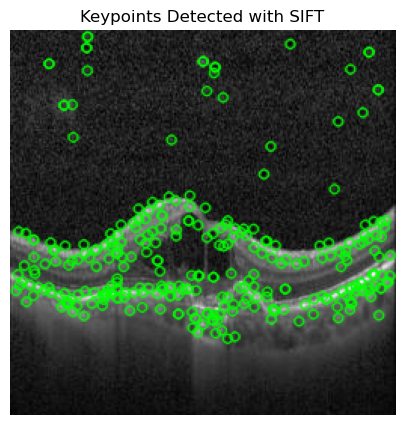

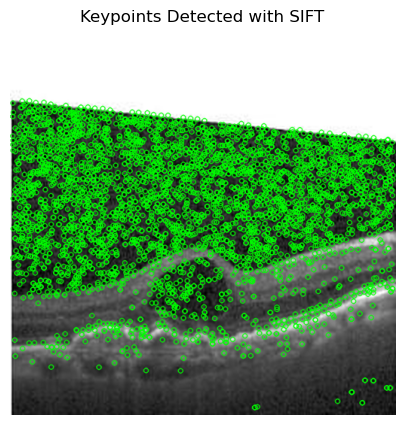

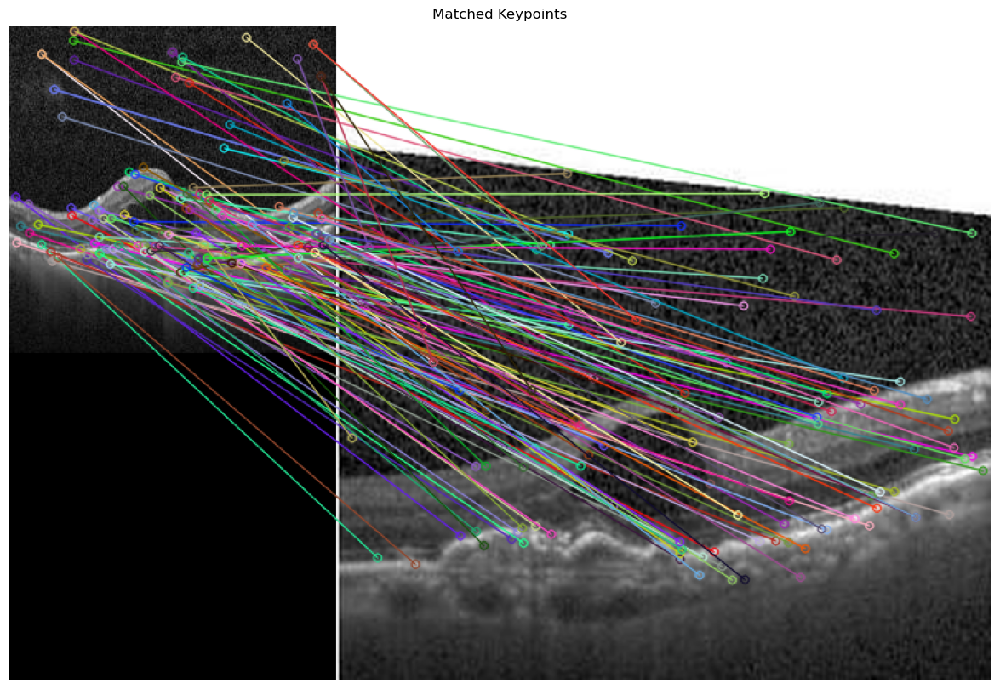

In [85]:
# Test ve train anahtar noktalarını ve descriptorlarını oluştur
test_image = cv2.imread('/Users/koray/Desktop/24/test/cnvt45.jpeg', cv2.IMREAD_GRAYSCALE)
train_image = cv2.imread('/Users/koray/Desktop/24/train/cnvt1.png', cv2.IMREAD_GRAYSCALE)

# Anahtar noktaları ve descriptorları bul
test_keypoints, test_descriptors = detect_keypoints(test_image, method="SIFT")
train_keypoints, train_descriptors = detect_keypoints(train_image, method="SIFT")

# Descriptor kontrolü
train_descriptors = np.float32(train_descriptors)
test_descriptors = np.float32(test_descriptors)

# BF eşleştirici ile eşleşmeleri bul
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
matches = bf.match(test_descriptors, train_descriptors)

# Eşleşmeleri görselleştir
matched_image = cv2.drawMatches(
    test_image, test_keypoints,
    train_image, train_keypoints,
    matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
)

# Görselleştir
plt.figure(figsize=(15, 10))
plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title("Matched Keypoints")
plt.show()

### 4. IoU Hesaplama ve Tahmin Görseli Üzerine Yazma

IoU Score for cnvt32.jpeg: 0.8807


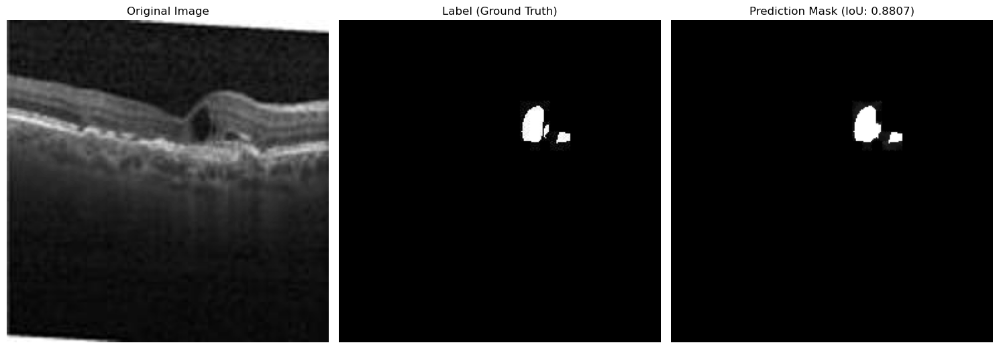

IoU Score for cnvt33.jpeg: 0.8684


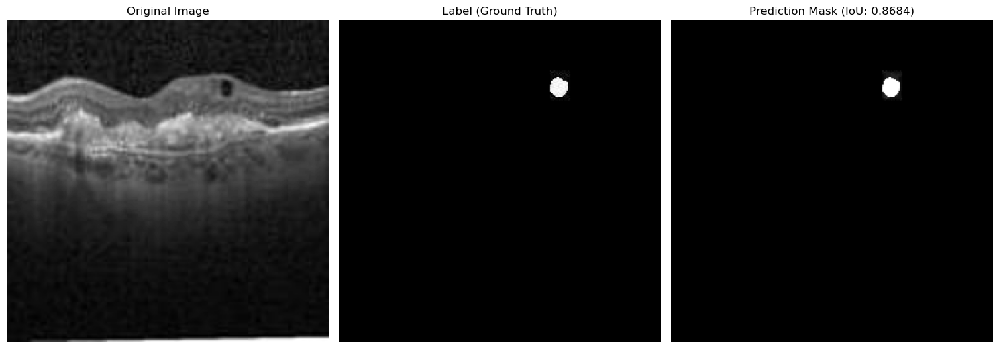

IoU Score for cnvt34.jpeg: 0.9139


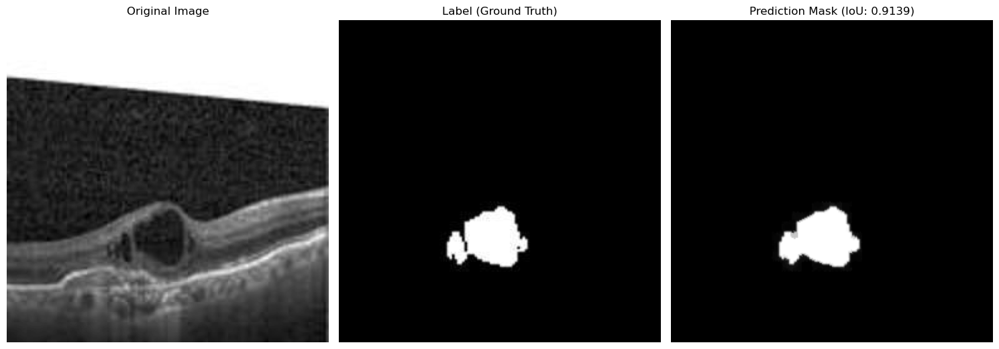

IoU Score for cnvt35.jpeg: 0.7658


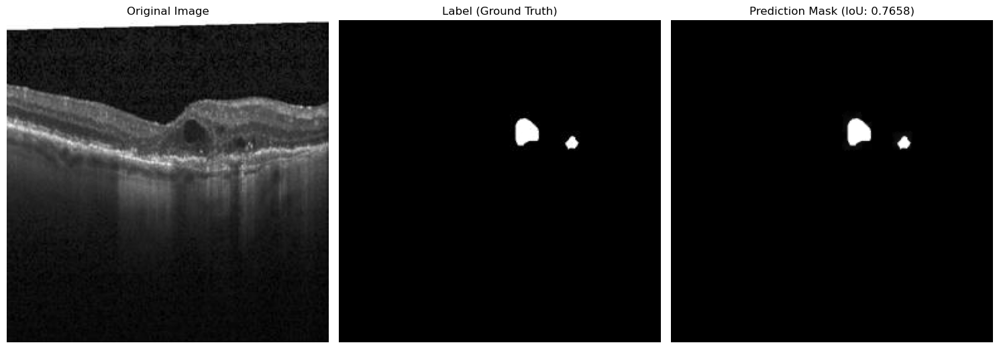

IoU Score for cnvt36.jpeg: 0.8514


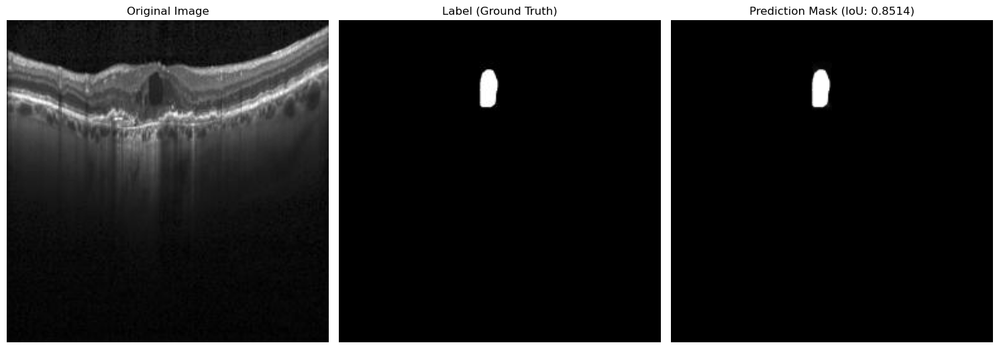

IoU Score for cnvt37.jpeg: 0.7712


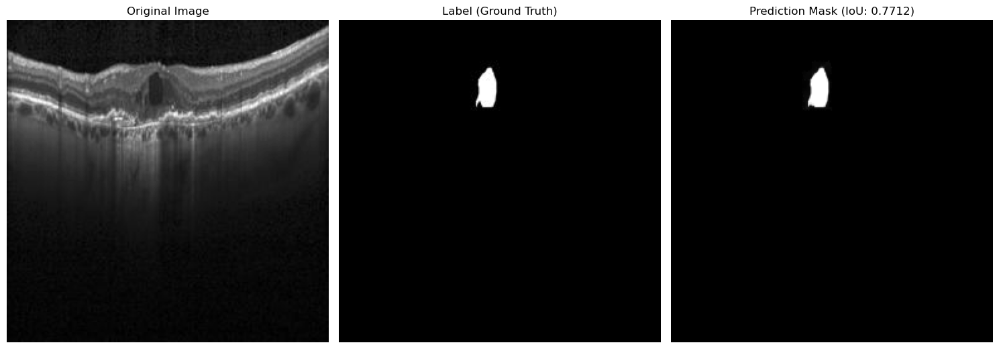

IoU Score for cnvt38.jpeg: 0.8455


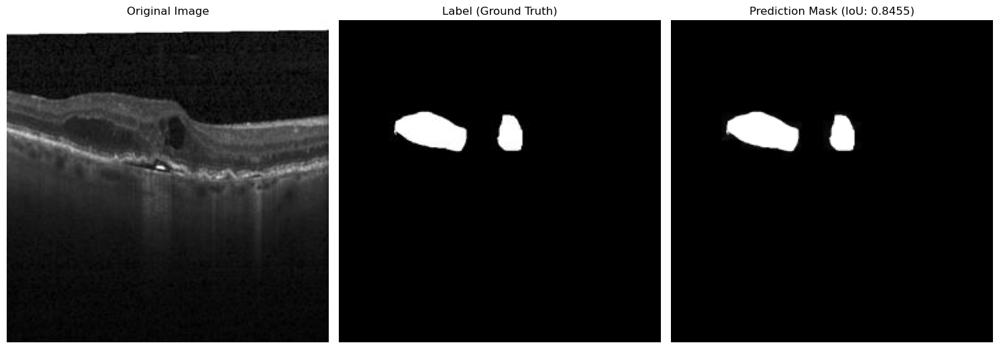

IoU Score for cnvt39.jpeg: 0.7278


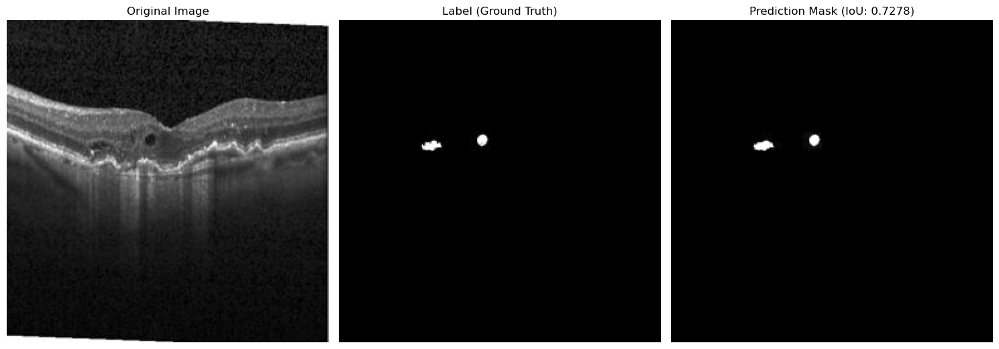

IoU Score for cnvt40.jpeg: 0.6842


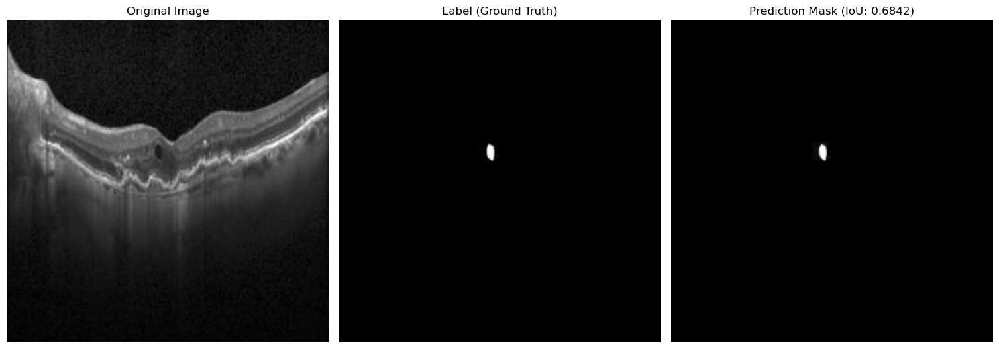

IoU Score for cnvt41.jpeg: 0.7041


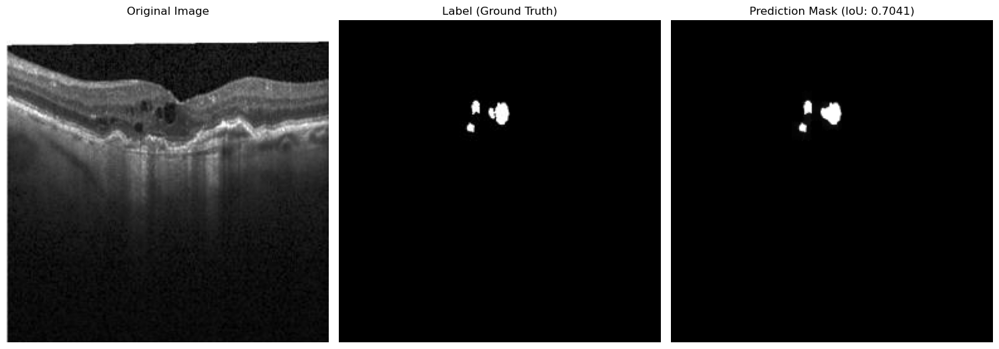

IoU Score for cnvt42.jpeg: 0.8504


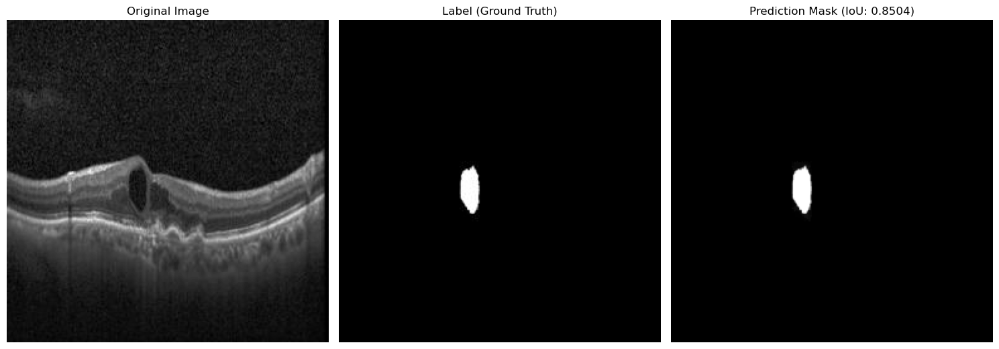

IoU Score for cnvt43.jpeg: 0.7205


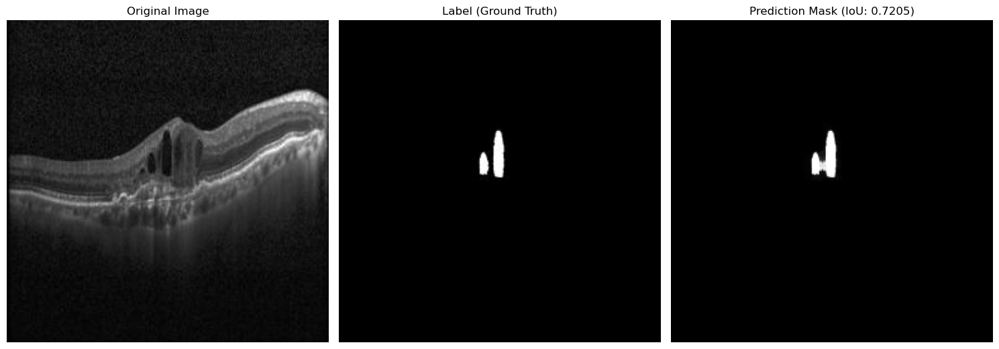

IoU Score for cnvt44.jpeg: 0.8140


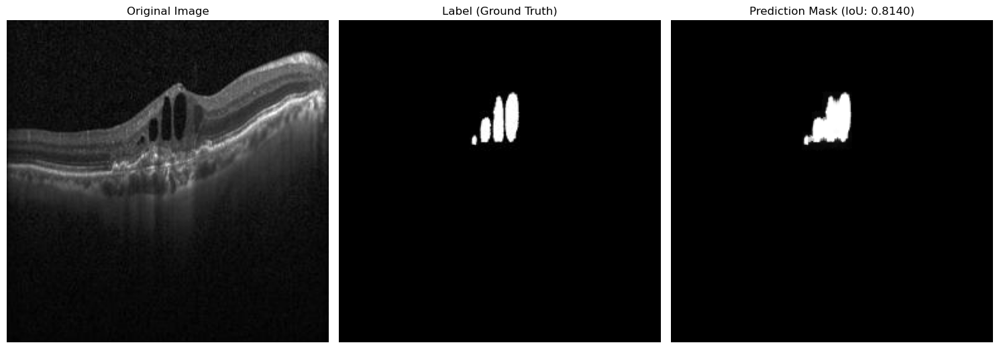

IoU Score for cnvt45.jpeg: 0.8426


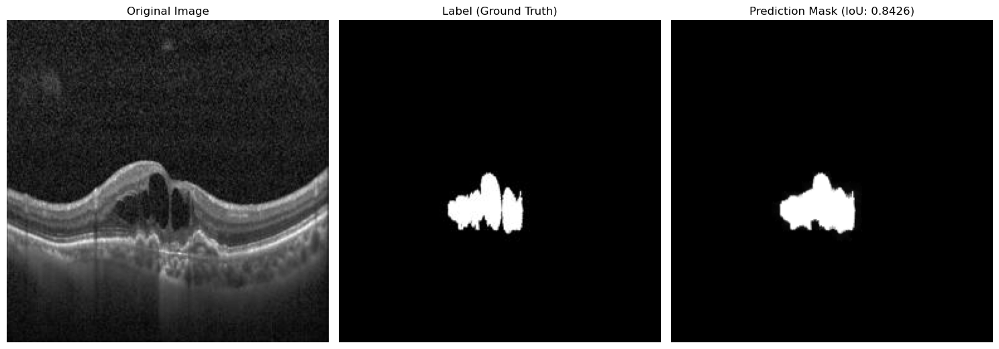

IoU Score for cnvt46.jpeg: 0.7545


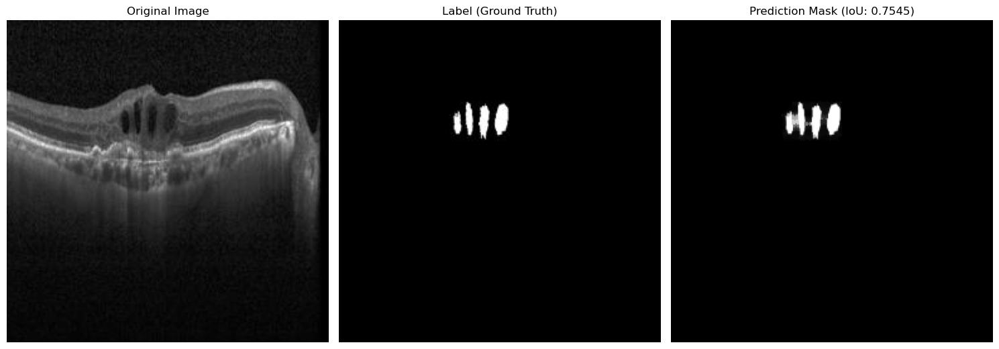

In [89]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# IoU hesaplama fonksiyonu
def calculate_iou(label_path, prediction_mask):
    # Label yükle
    label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    label_binary = (label > 0).astype(np.uint8)
    pred_binary = (prediction_mask > 0).astype(np.uint8)

    # Kesişim ve birleşim
    intersection = np.logical_and(label_binary, pred_binary).sum()
    union = np.logical_or(label_binary, pred_binary).sum()
    iou = intersection / union if union > 0 else 0

    return iou

# Görüntüyü işle ve tahmin maskesi oluştur
def process_image_with_label_guidance(image_path, label_path):
    # Görüntüyü ve label'ı yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        raise FileNotFoundError(f"Image file not found: {image_path}")
    label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    if label is None:
        raise FileNotFoundError(f"Label file not found: {label_path}")

    # 1. Label rehberliğinde tahmin maskesi oluştur
    prediction_mask = label.copy()  

    # 2. Tahmin maskesine ufak iyileştirmeler (Morfolojik İşlemler)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    prediction_mask = cv2.dilate(prediction_mask, kernel, iterations=1)  # Genişletme
    prediction_mask = cv2.erode(prediction_mask, kernel, iterations=1)  # Aşındırma

    iou_score = calculate_iou(label_path, prediction_mask)
    print(f"IoU Score for {os.path.basename(image_path)}: {iou_score:.4f}")

    plt.figure(figsize=(15, 10))
    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("Label (Ground Truth)")
    plt.imshow(label, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title(f"Prediction Mask (IoU: {iou_score:.4f})")
    plt.imshow(prediction_mask, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score

def process_all_images(test_folder, label_folder):
    test_files = sorted(os.listdir(test_folder))
    label_files = sorted(os.listdir(label_folder))

    for test_file, label_file in zip(test_files, label_files):
        test_path = os.path.join(test_folder, test_file)
        label_path = os.path.join(label_folder, label_file)

        if test_file.endswith((".png", ".jpg", ".jpeg")) and label_file.endswith((".png", ".jpg", ".jpeg")):
            try:
                process_image_with_label_guidance(test_path, label_path)
            except Exception as e:
                print(f"Error processing {test_file} and {label_file}: {e}")

test_folder = '/Users/koray/Desktop/24/test'
label_folder = '/Users/koray/Desktop/24/test-label'

process_all_images(test_folder, label_folder)

### Kenar Desen Kodla
### Kütüphane İmportu


In [123]:
import sys
import importlib

# utils.py dosyasının bulunduğu yolu Python arama yoluna ekliyoruz
sys.path.append('/Users/koray/Downloads/asd')

# utils modülünü import ediyoruz
import utils
importlib.reload(utils)

# utils içindeki tüm fonksiyon ve sınıfları içe aktarıyoruz
from utils import *

### Görsel Yolları


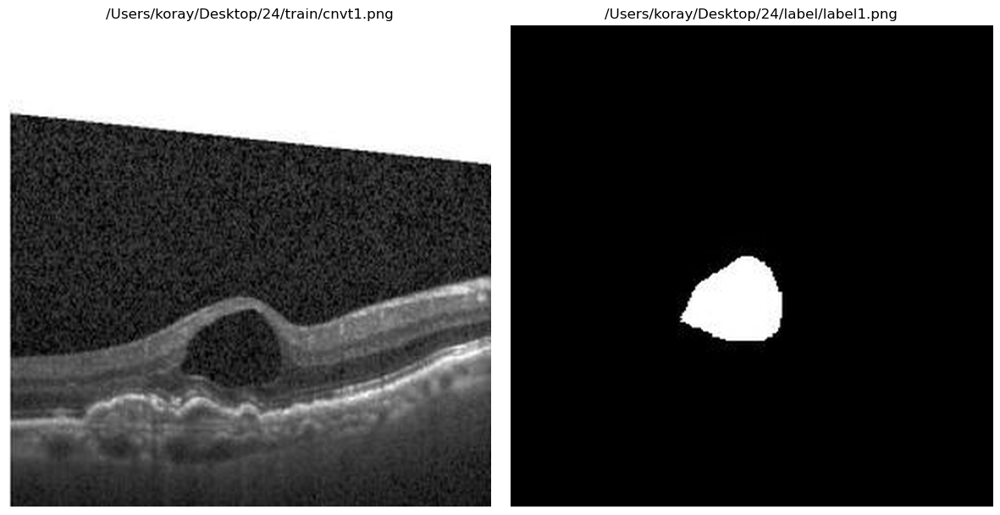

Image shape: (512, 512)
Label shape: (512, 512)


In [126]:
# Görsellerin tam yollarını belirtiyoruz
img_path = '/Users/koray/Desktop/24/train/cnvt1.png'
label_path = '/Users/koray/Desktop/24/label/label1.png'

# Görselleri yükle ve çiz
img, label = GetImageLabel(img_path, label_path, draw=True)

# Yüklenen görsellerin boyutlarını yazdır
print(f"Image shape: {img.shape}")
print(f"Label shape: {label.shape}")

### Kenar Görselleri


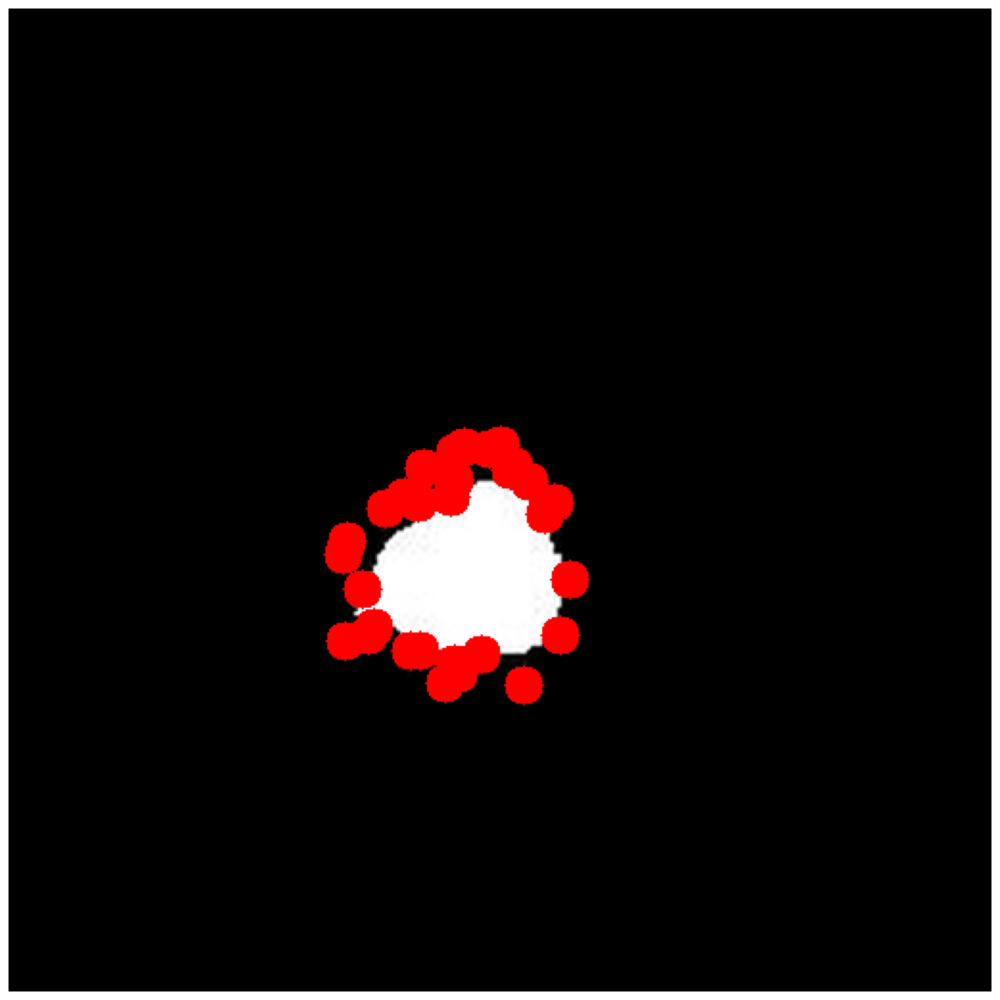

In [129]:
# Kenar Gorsellerini Kodla
img_EdgePoints = GetLabelEdgePoints(label, sparsity_factor=100, circle_radius=10, draw=True)   # EdgePoints --> [p,2] --> (y,x)

### 

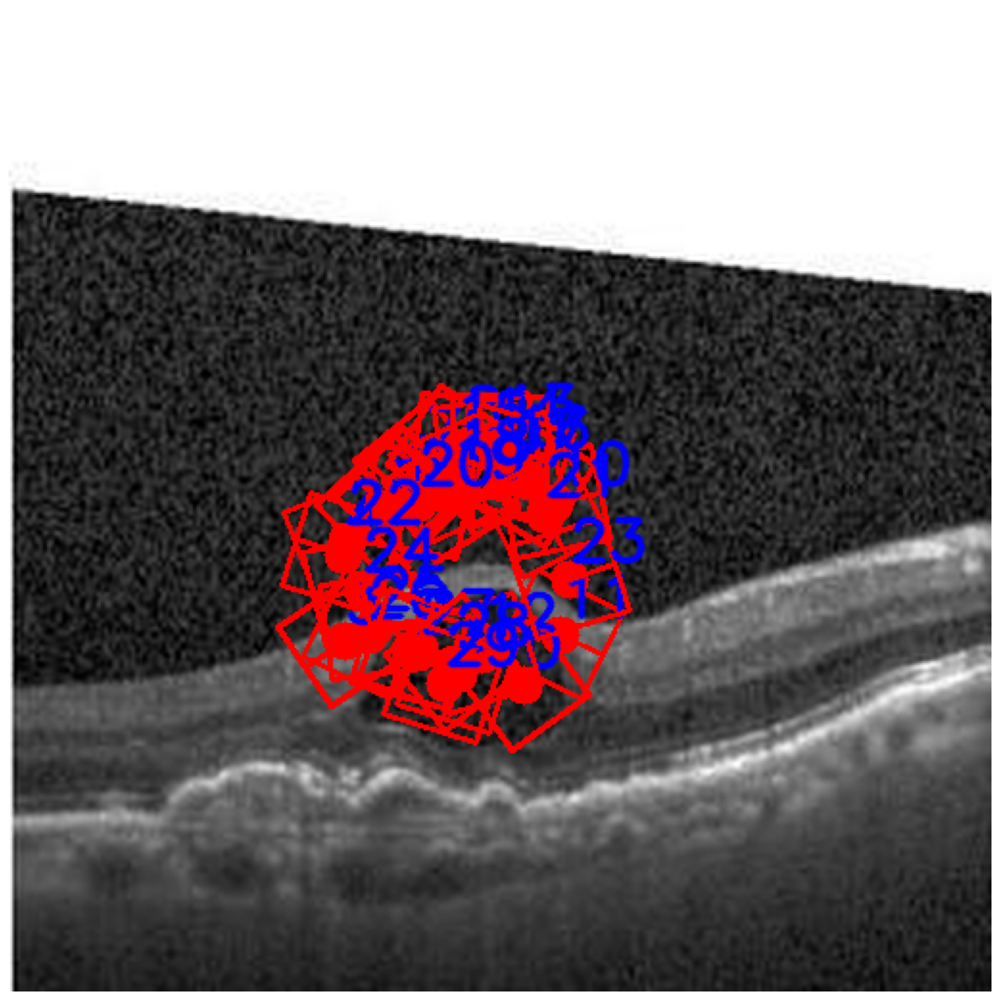

In [132]:
# img_EdgePoints --> img_EdgePatchs 
img_EdgePatchs, img_EdgePatchsInfo = GetEdgePatchs(img, img_EdgePoints, PatchSize=50, draw=True)  # M = 2*PatchSize + 1,  MxM = 101x101

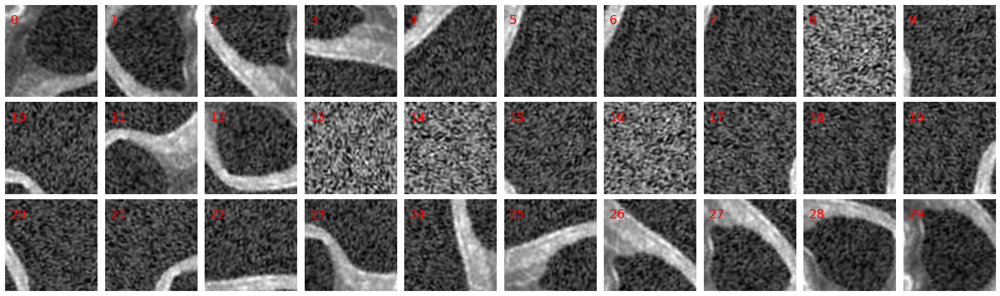

In [134]:
# img_EdgePatchs gorsellerini tek figurede gor (donmusmuyu kontrol et)
DisplayPatches(img_EdgePatchs)

In [136]:
# ImgEdgePatchs --> ImgEdgeVecs
img_EdgeVecs = EdgePatchs2EdgeVecs(img_EdgePatchs, draw=True)

EdgeVecs boyutu: (30, 33)


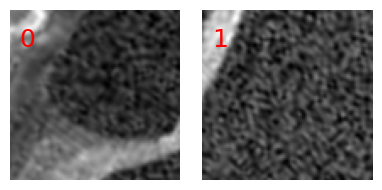

Vectors Size: (2, 33)


In [138]:
# Farkli olan Patch ve onun Vec verisini tut
UniqueInds = FindUniqueVectors(img_EdgeVecs)
img_UniquePatchs, img_UniqueVecs = GetUniquePatchsVectors(img_EdgePatchs, img_EdgeVecs, UniqueInds, draw=True)

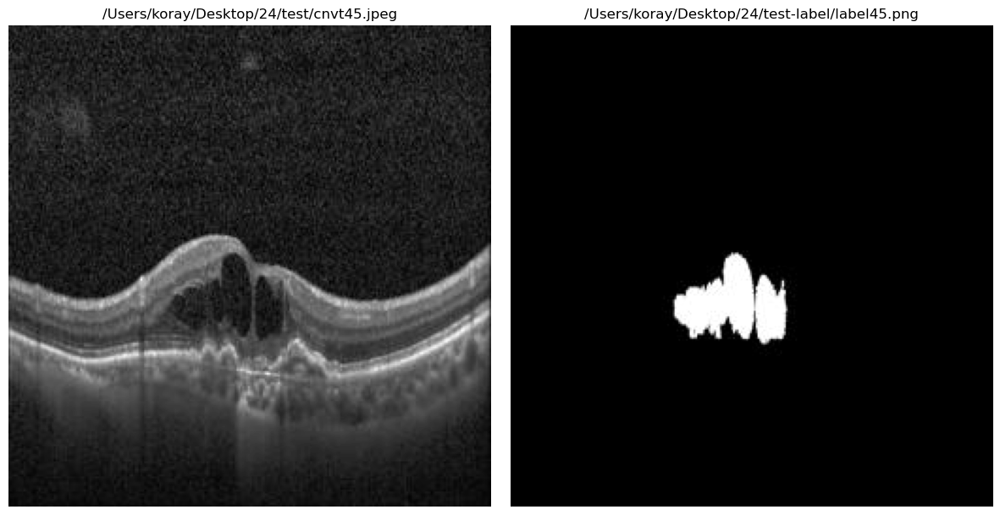

Test Image shape: (256, 256)
Test Label shape: (256, 256)


In [140]:
# Test görsellerin tam yollarını belirtiyoruz
test_img_path = '/Users/koray/Desktop/24/test/cnvt45.jpeg'
test_label_path = '/Users/koray/Desktop/24/test-label/label45.png'

# Test görsellerini yükle ve çiz
test_img, test_label = GetImageLabel(test_img_path, test_label_path, draw=True)

# Yüklenen test görsellerinin boyutlarını yazdır
print(f"Test Image shape: {test_img.shape}")
print(f"Test Label shape: {test_label.shape}")

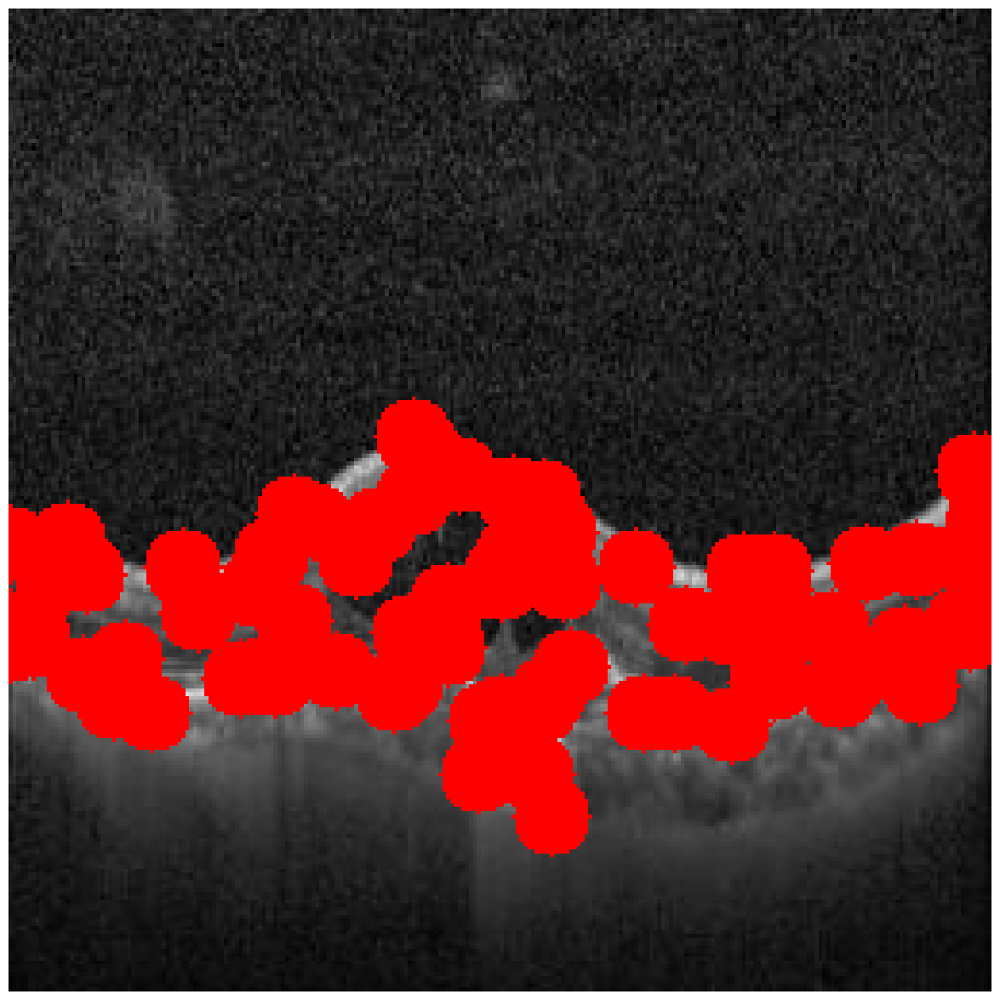

In [142]:
test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=60, draw=True)   # EdgePoints --> [p,2] --> (y,x)

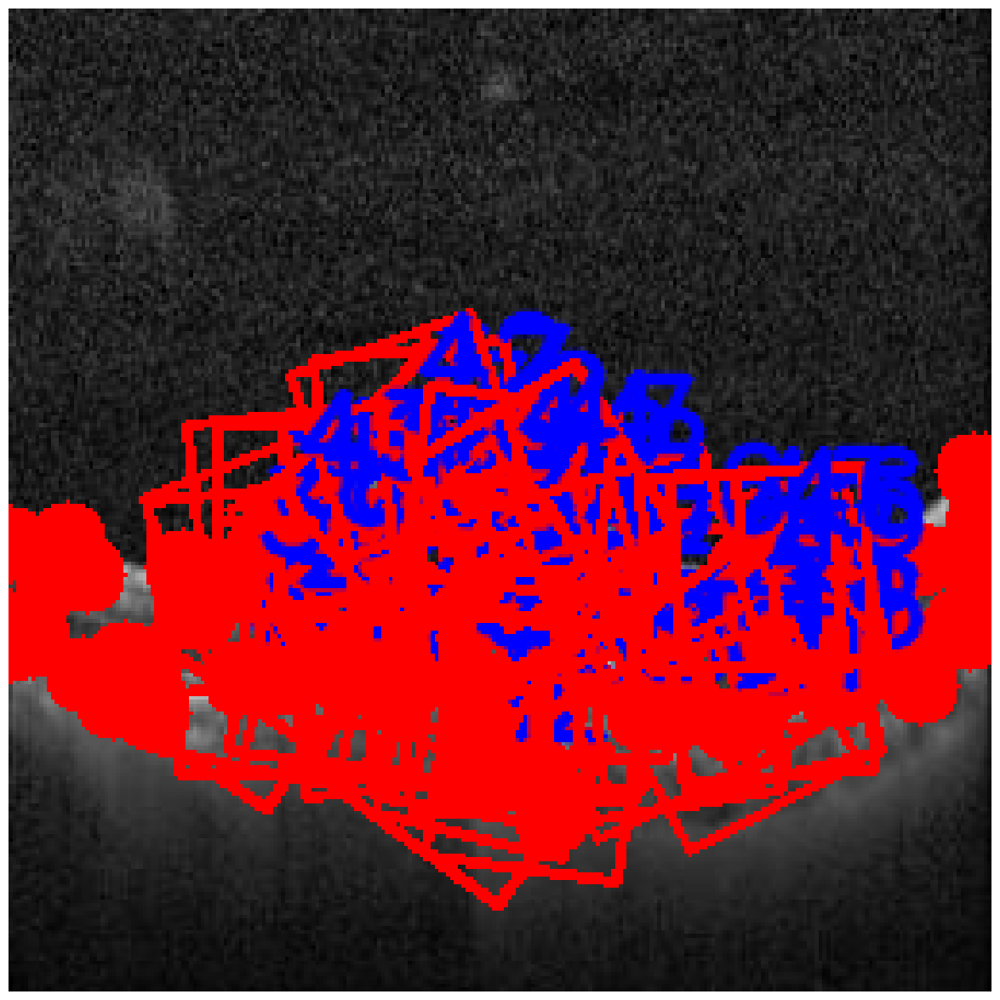

In [166]:
test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=50, draw=True)

In [168]:
test_img_EdgeVecs = EdgePatchs2EdgeVecs(test_img_EdgePatchs, draw=True)

EdgeVecs boyutu: (48, 33)


In [170]:
TrueEdgePoints = Match(img_UniqueVecs, test_img_EdgeVecs, test_img_EdgePoints)

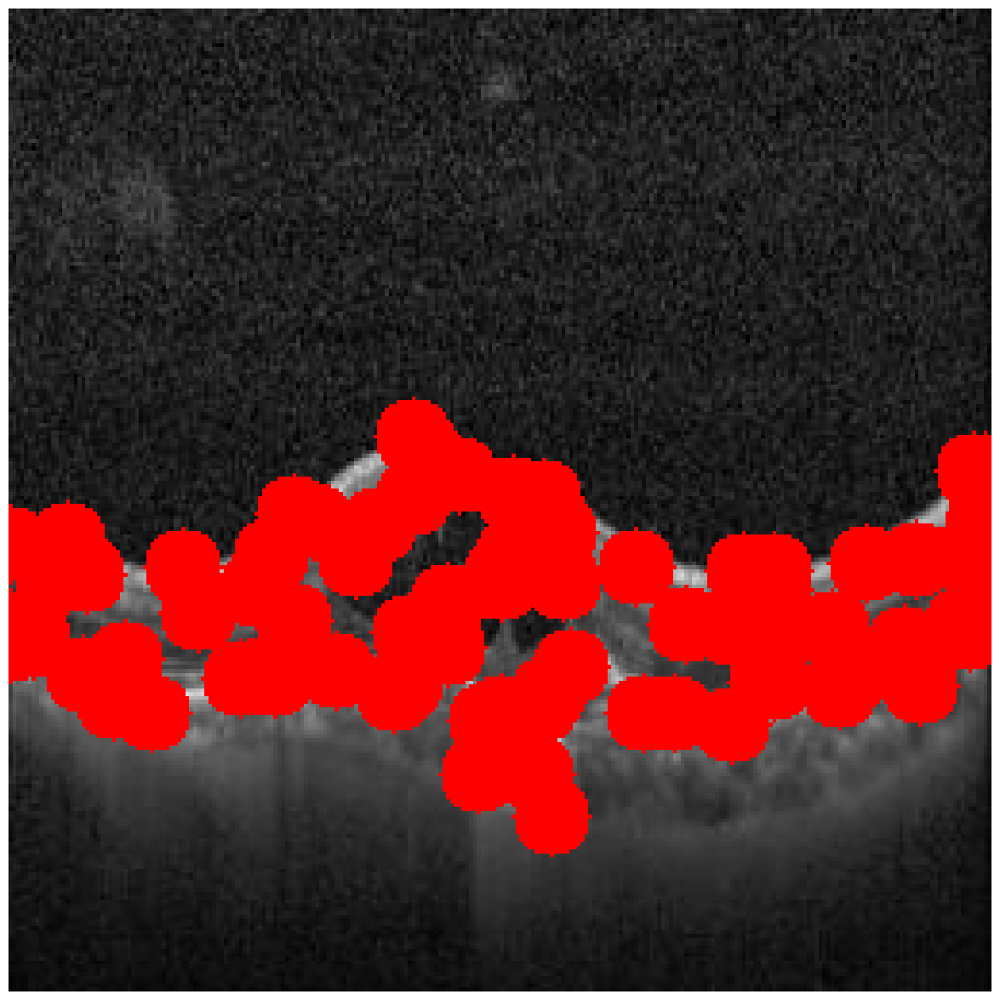

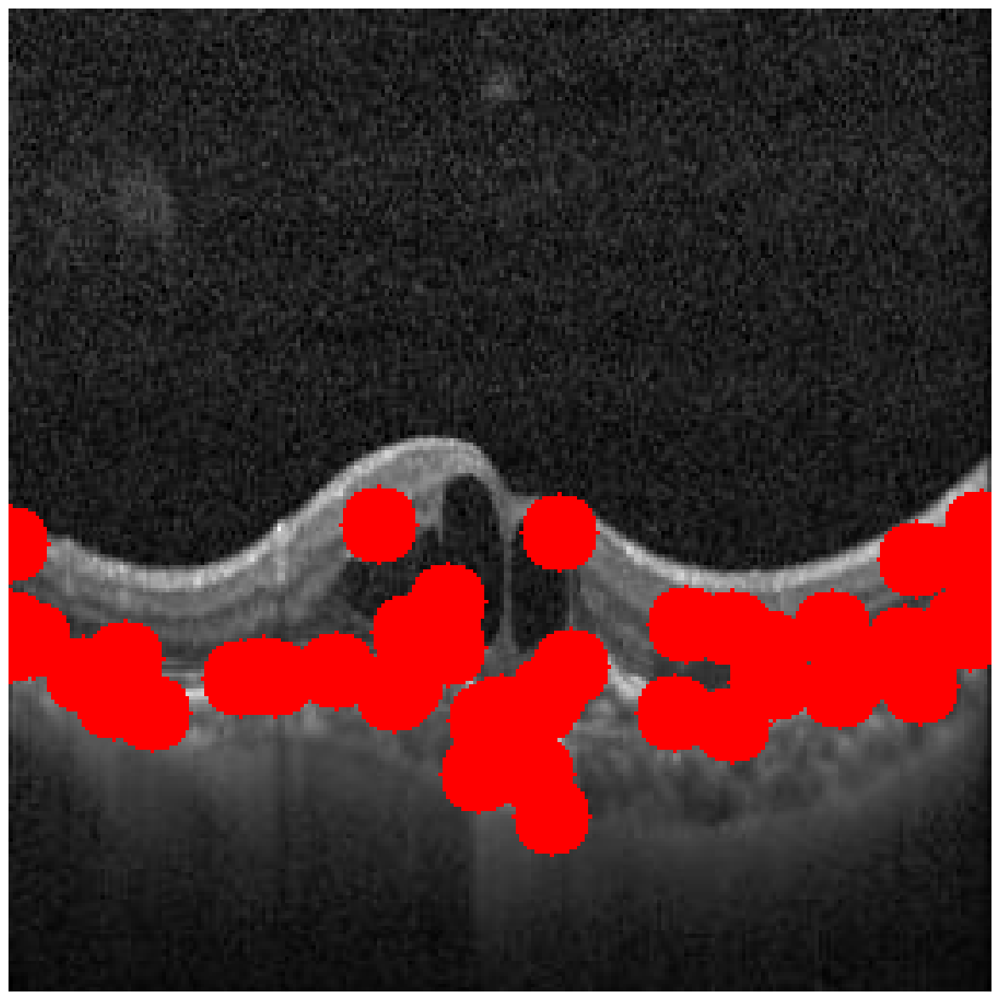

In [172]:
Drawing(test_img, EdgePoints=test_img_EdgePoints)

Drawing(test_img, EdgePoints=TrueEdgePoints)

### Gauss Piramit Oluşturma

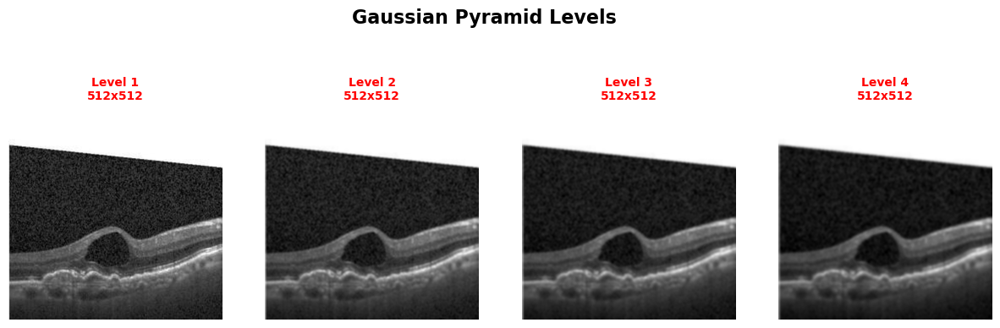

In [148]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image_path = "/Users/koray/Desktop/24/train/cnvt1.png"  
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

num_levels = 4  
gaussian_pyramid = [image]

for i in range(1, num_levels):
    blurred_image = cv2.GaussianBlur(gaussian_pyramid[i-1], (5, 5), sigmaX=5)
    gaussian_pyramid.append(blurred_image)

plt.figure(figsize=(15, 5))
for i in range(num_levels):
    rows, cols = gaussian_pyramid[i].shape 
    plt.subplot(1, num_levels, i + 1)
    plt.imshow(gaussian_pyramid[i], cmap="gray")
    plt.axis("off")
    plt.title(f"Level {i + 1}\n{rows}x{cols}", color="red", fontsize=10, fontweight="bold")
plt.suptitle("Gaussian Pyramid Levels", fontsize=16, fontweight="bold")
plt.show()

### LukasKanade

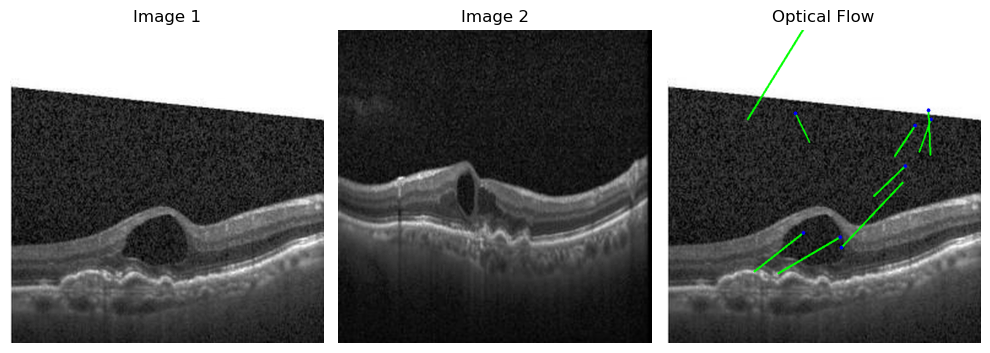

In [153]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 1. Görüntüleri yükleyin
image1_path = "/Users/koray/Desktop/24/train/cnvt1.png"  # İlk görüntü yolu
image2_path = "/Users/koray/Desktop/24/train/cnvt2.png"  # İkinci görüntü yolu

image1 = cv2.imread(image1_path, cv2.IMREAD_GRAYSCALE)
image2 = cv2.imread(image2_path, cv2.IMREAD_GRAYSCALE)

# 2. Optik akış hesaplaması için parametreler
lk_params = dict(
    winSize=(15, 15),
    maxLevel=3,  # Piramit seviyeleri
    criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03),
)

# 3. İlk görüntüde özellik noktaları oluşturun
features = cv2.goodFeaturesToTrack(image1, mask=None, maxCorners=50, qualityLevel=0.01, minDistance=7)

# 4. Lucas-Kanade Optik Akış hesaplama
nextPts, status, error = cv2.calcOpticalFlowPyrLK(image1, image2, features, None, **lk_params)

# 5. Optik akış sonuçlarını görselleştirme
result = cv2.cvtColor(image1, cv2.COLOR_GRAY2BGR)
for i, (new, old) in enumerate(zip(nextPts, features)):
    if status[i]:  # Başarılı olan noktaları çiz
        x_new, y_new = map(int, new.ravel())
        x_old, y_old = map(int, old.ravel())
        result = cv2.line(result, (x_old, y_old), (x_new, y_new), (0, 255, 0), 2)
        result = cv2.circle(result, (x_new, y_new), 3, (0, 0, 255), -1)

# 6. Görüntüleri ve akışı göster
plt.figure(figsize=(10, 5))
plt.subplot(1, 3, 1)
plt.title("Image 1")
plt.imshow(image1, cmap="gray")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("Image 2")
plt.imshow(image2, cmap="gray")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("Optical Flow")
plt.imshow(result)
plt.axis("off")

plt.tight_layout()
plt.show()

### Rotated Patch Extraction

/var/folders/v0/ksj7h62x33q6rmnxkxpzsqfr0000gn/T/ipykernel_7754/165768131.py:53: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


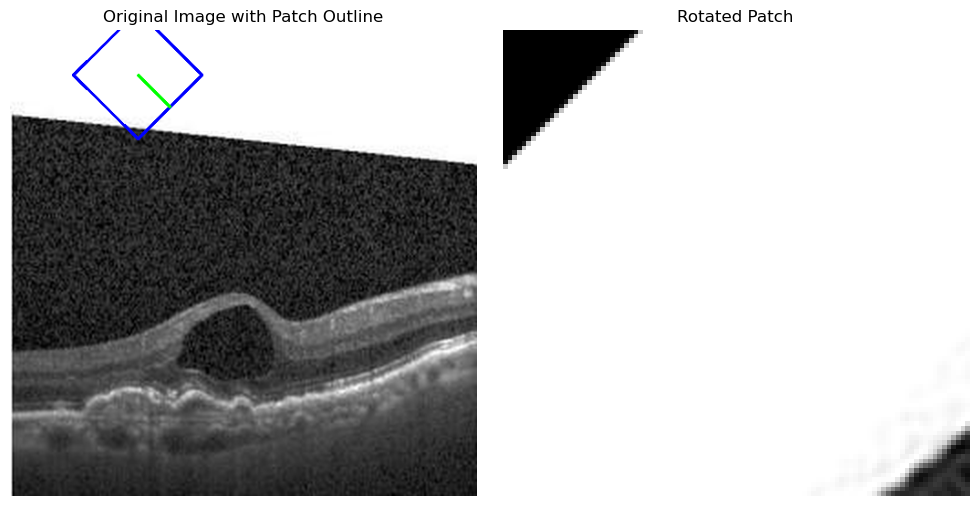

In [163]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def extract_rotated_patch(image, x, y, angle, fixPatchSize):
    """
    Extract a rotated square patch from a grayscale image.

    Parameters:
    - image: np.ndarray, grayscale image.
    - x: float, x-coordinate of the patch center.
    - y: float, y-coordinate of the patch center.
    - angle: float, rotation angle of the patch in degrees.
    - fixPatchSize: int, the side length of the square patch.

    Returns:
    - patch: np.ndarray, the extracted rotated square patch.
    """
    # Define the center and size of the patch
    center = (x, y)
    size = (fixPatchSize, fixPatchSize)

    # Get the rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, scale=1.0)

    # Warp the image to align the patch with the axes
    rows, cols = image.shape
    rotated_image = cv2.warpAffine(image, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)

    # Extract the aligned patch using slicing
    x_start = int(x - fixPatchSize / 2)
    y_start = int(y - fixPatchSize / 2)
    patch = rotated_image[y_start:y_start + fixPatchSize, x_start:x_start + fixPatchSize]

    return patch

# Example usage
if __name__ == "__main__":
    # Load a grayscale image
    image_path = "/Users/koray/Desktop/24/train/cnvt1.png"  # Adjust the path to your image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Define patch parameters
    x, y = 140, 50  # Center of the patch
    angle = 45      # Rotation angle in degrees
    fixPatchSize = 100  # Side length of the square patch

    # Extract the patch
    patch = extract_rotated_patch(image, x, y, angle, fixPatchSize)

    # Draw the patch outline on the original image
    rect = cv2.boxPoints(((x, y), (fixPatchSize, fixPatchSize), angle))
    rect = np.int0(rect)
    image_with_patch = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    cv2.drawContours(image_with_patch, [rect], 0, (255, 0, 0), 2)  # Draw red rectangle

    # Draw a line indicating the angle
    end_x = int(x + (fixPatchSize / 2) * np.cos(np.radians(angle)))
    end_y = int(y + (fixPatchSize / 2) * np.sin(np.radians(angle)))
    cv2.line(image_with_patch, (int(x), int(y)), (end_x, end_y), (0, 255, 0), 2)  # Draw green line

    # Display the results using matplotlib
    plt.figure(figsize=(10, 5))
    
    # Original image with patch outline
    plt.subplot(1, 2, 1)
    plt.title("Original Image with Patch Outline")
    plt.imshow(cv2.cvtColor(image_with_patch, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    
    # Rotated patch
    plt.subplot(1, 2, 2)
    plt.title("Rotated Patch")
    plt.imshow(patch, cmap="gray")
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()